Load required libraries

In [9]:
from netCDF4 import Dataset, num2date
import numpy as np
import pandas as pd
import xarray as xr
import os
import time
import matplotlib.pyplot as plt
import matplotlib
import gc
from matplotlib import transforms
import matplotlib.colors as clrs
import glob

Load in observation data

In [10]:
for i in np.arange(0,12):
    filename = "/home/stod000/space/DATA/SOCAT/SOCAT_monthly_"+str(i+1)+"_1962_to_2020_CREG025.nc"
    data = Dataset(filename, "r", format="NETCDF4")
    X = data.variables['fCO2water_SST_wet'][:]
    if i==0:
        [ny,nx]=np.shape(X)
        obsPCO2=np.zeros((12,ny,nx))
    obsPCO2[i,:,:]=X

print(type(obsPCO2))
print(np.shape(obsPCO2))


/tmp/ipykernel_6066/30887102.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  X = data.variables['fCO2water_SST_wet'][:]


<class 'numpy.ndarray'>
(12, 735, 528)


Load in model output data (only need to run this cell if you're making plots other than the books)

In [11]:
filein = ("/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc")
data = Dataset(filein, "r", format="NETCDF4")
print(data)

modPCO2 = data.variables['pco2'][:]
print(np.shape(modPCO2))



<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF4 data model, file format HDF5):
    dimensions(sizes): x(528), y(735), time(12)
    variables(dimensions): float32 nav_lat(y, x), float32 nav_lon(y, x), float32 time(time), float32 pco2(time, y, x)
    groups: 
(12, 735, 528)


/tmp/ipykernel_6066/623026445.py:5: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]


Load region mask and CREG025 mask

In [12]:
data_file = Dataset("/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/regions_mask_6.nc", "r", format="NETCDF4")
regindx = (data_file['regions_mask'][:])
print(regindx.shape)

data_file = Dataset("/home/fid000/WORK7/ANALYSIS/DATA/CREG025_mesh_mask.nc", "r", format="NETCDF4")
tmask = (data_file['tmask'][0,:,:,:])
print(tmask.shape)

print(np.nanmin(regindx),np.nanmean(regindx),np.nanmax(regindx))
print(np.min(tmask),np.mean(tmask),np.max(tmask))

tmask0=tmask[0,:,:].squeeze()

nxy=np.size(regindx)
I = np.reshape(regindx, (nxy,))
nreg=int(max(I))
mask = regindx
mask = mask.flatten()

/tmp/ipykernel_6066/2096643997.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  regindx = (data_file['regions_mask'][:])
/tmp/ipykernel_6066/2096643997.py:6: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tmask = (data_file['tmask'][0,:,:,:])


(735, 528)
(75, 735, 528)
0.0 2.0095472683383417 9.0
0 0.3011297327011613 1


Output scatterplots of model vs obs for month and regions

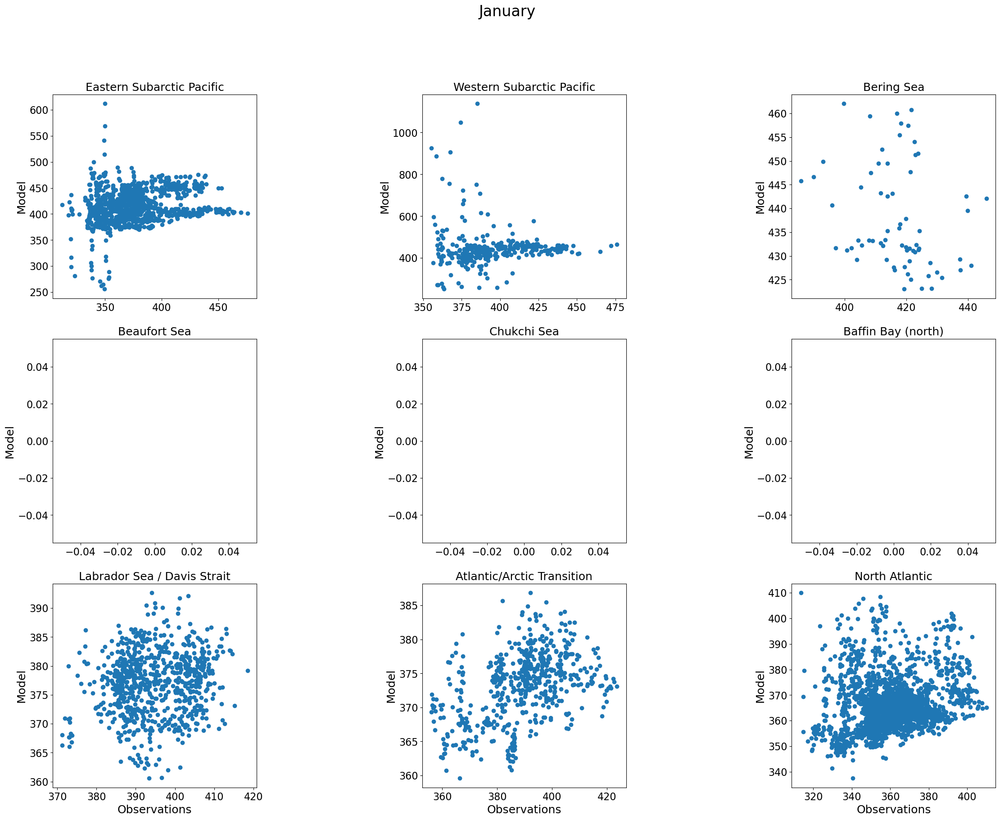

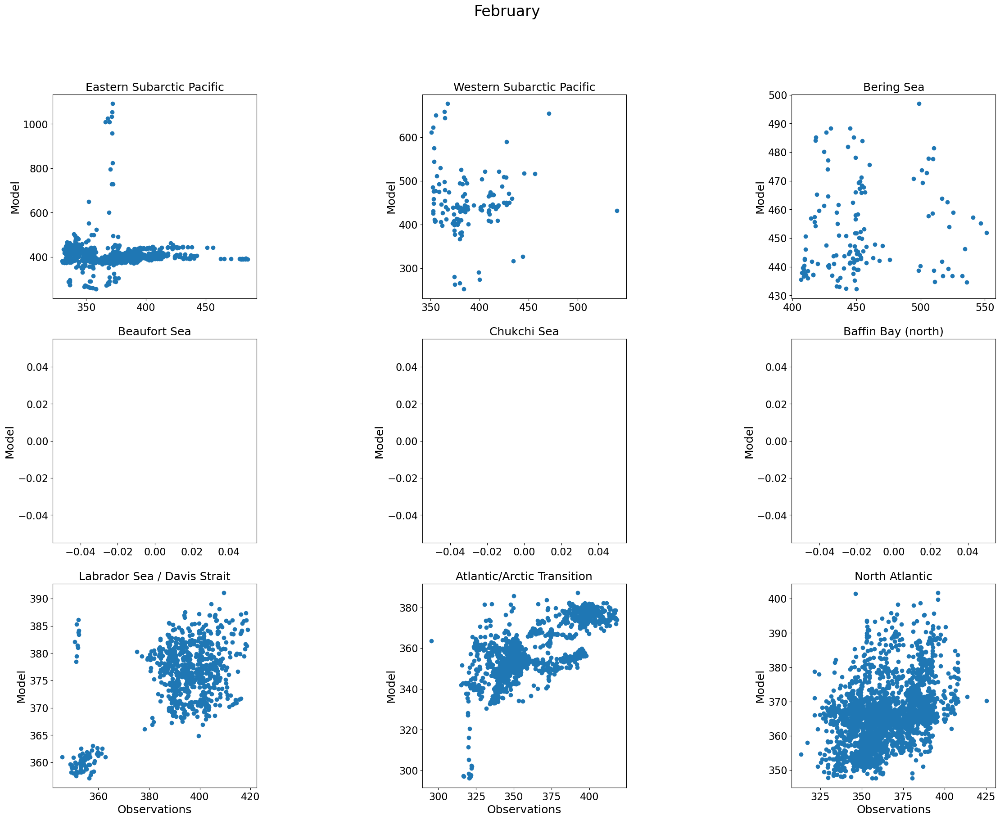

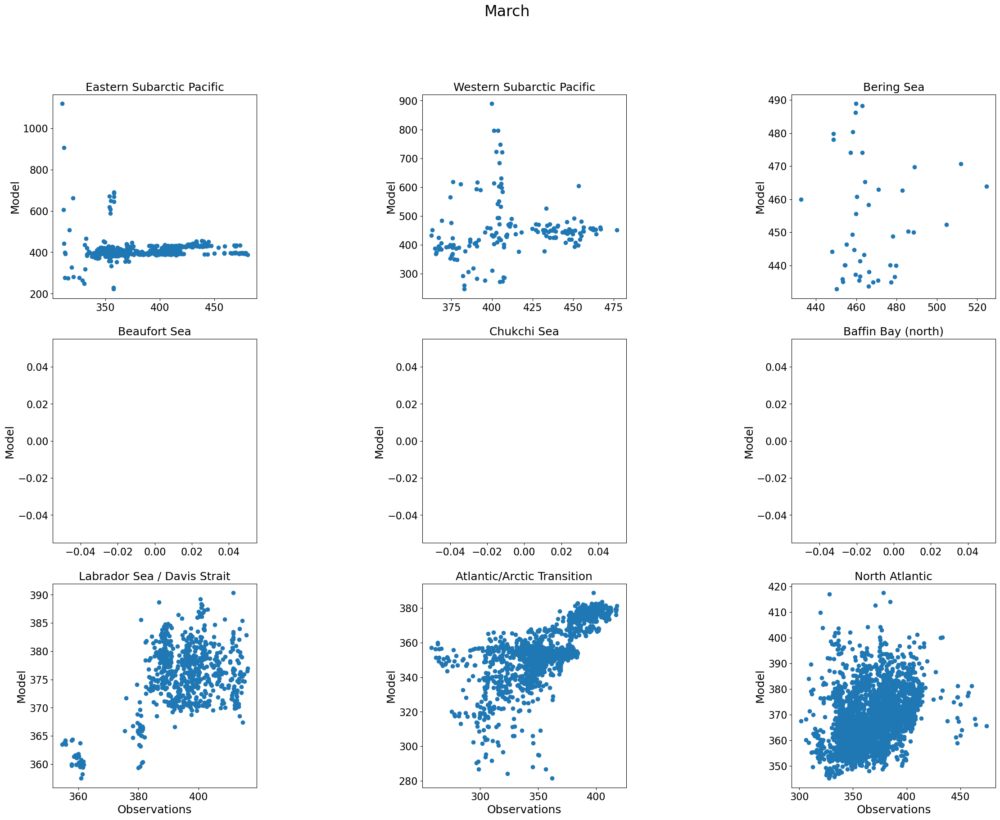

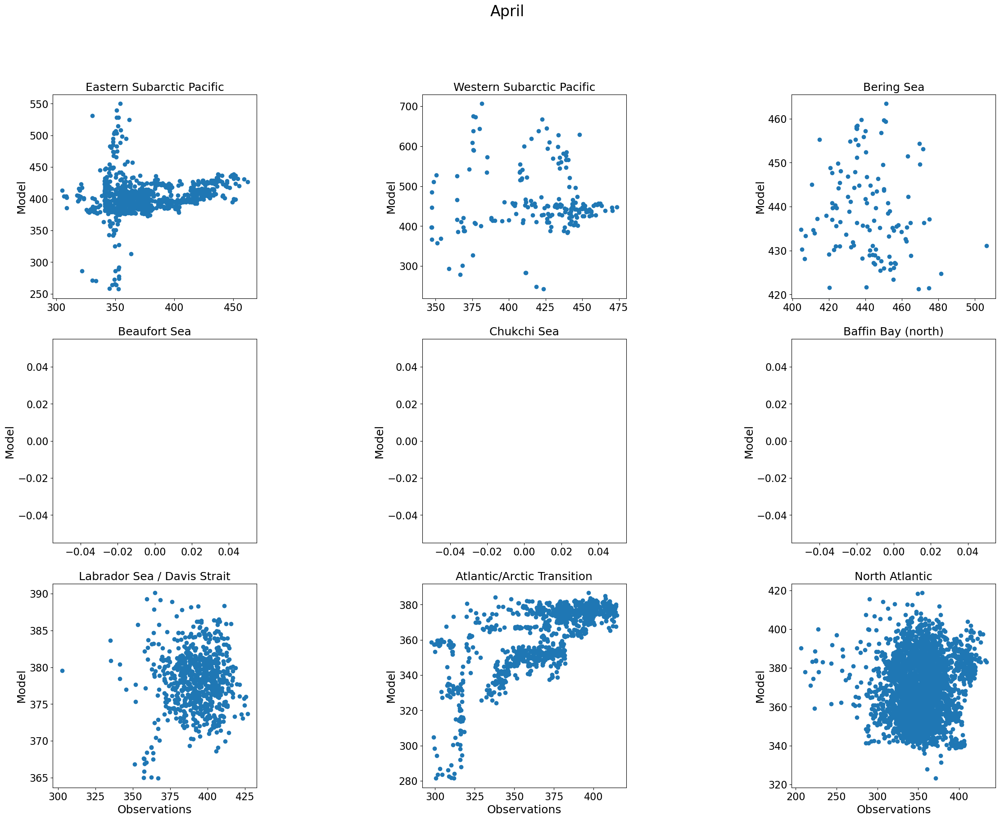

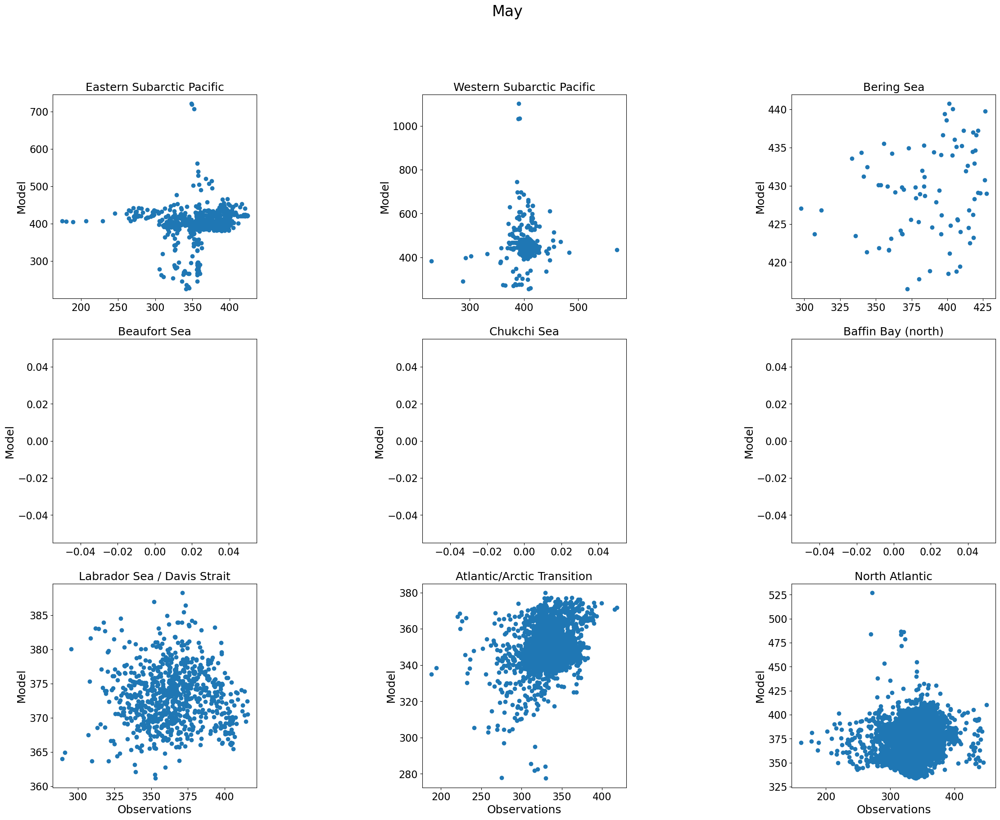

...

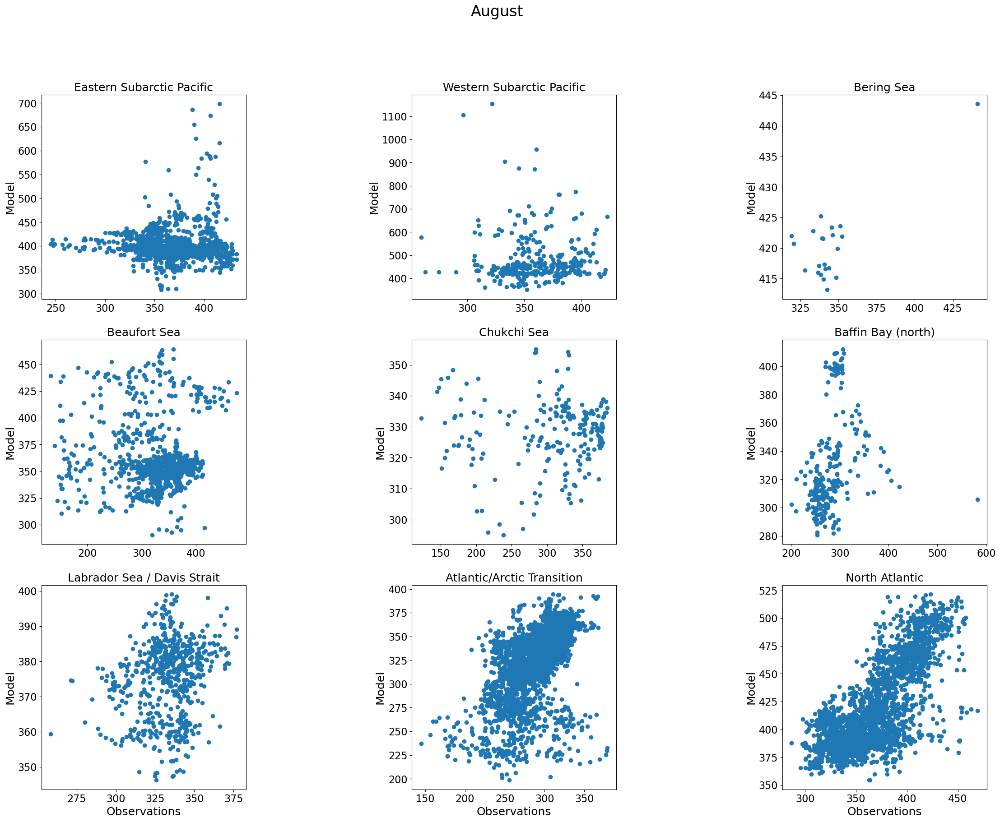

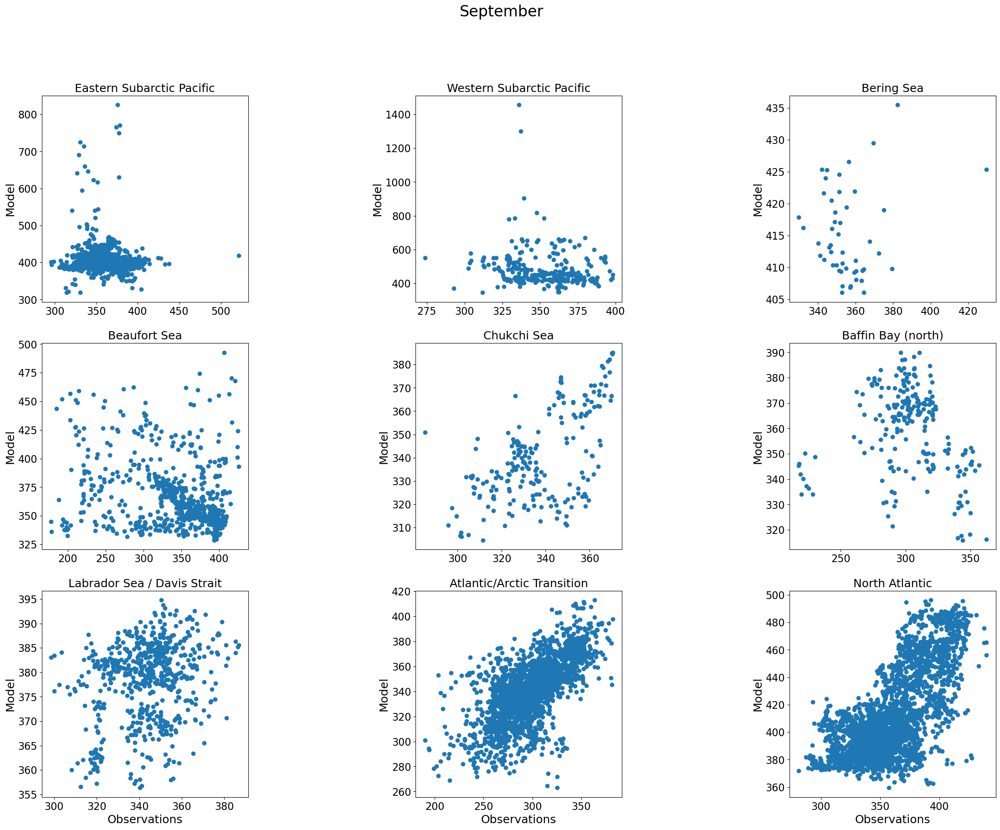

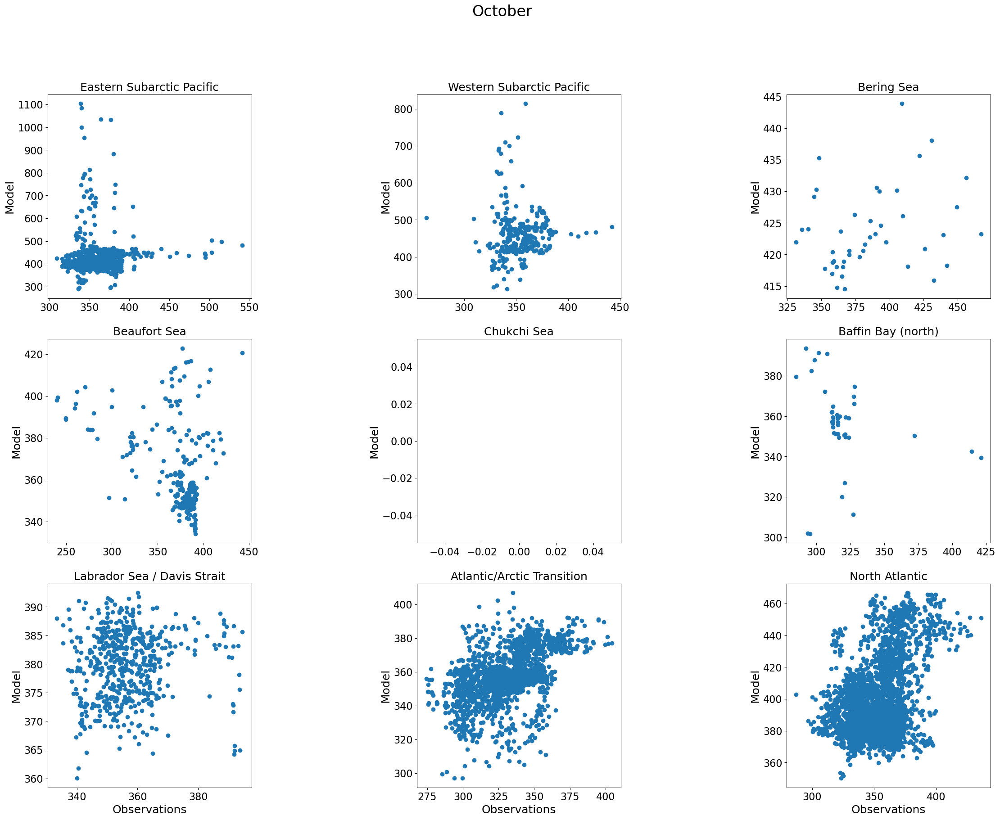

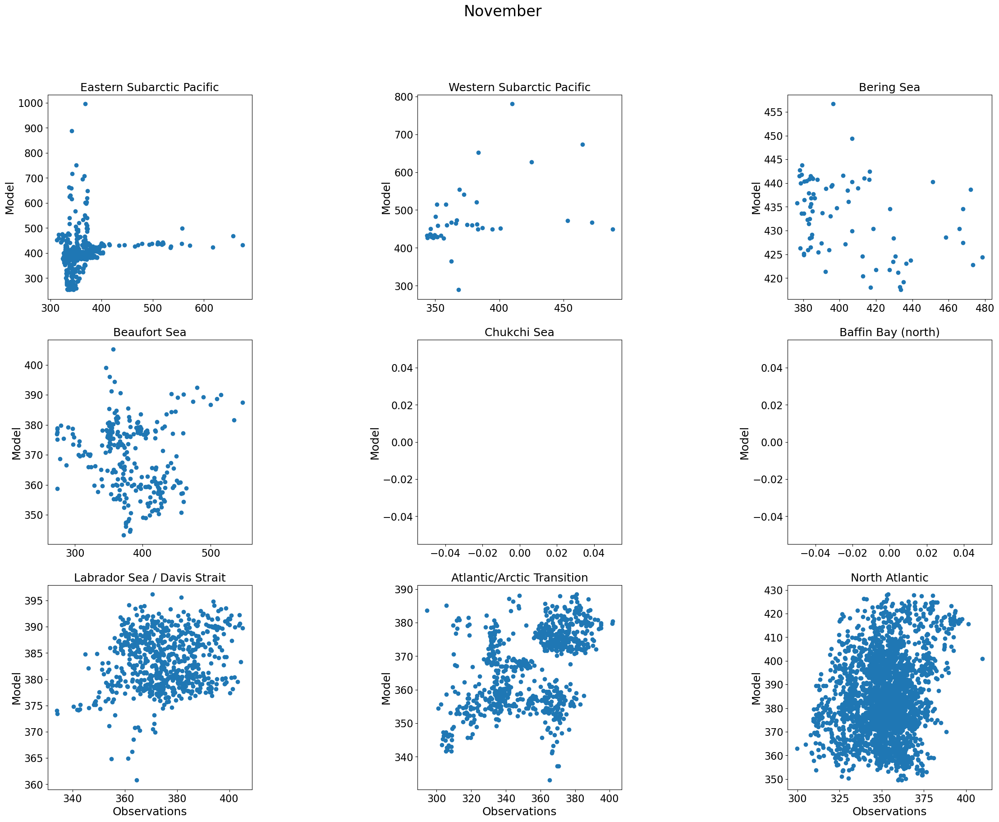

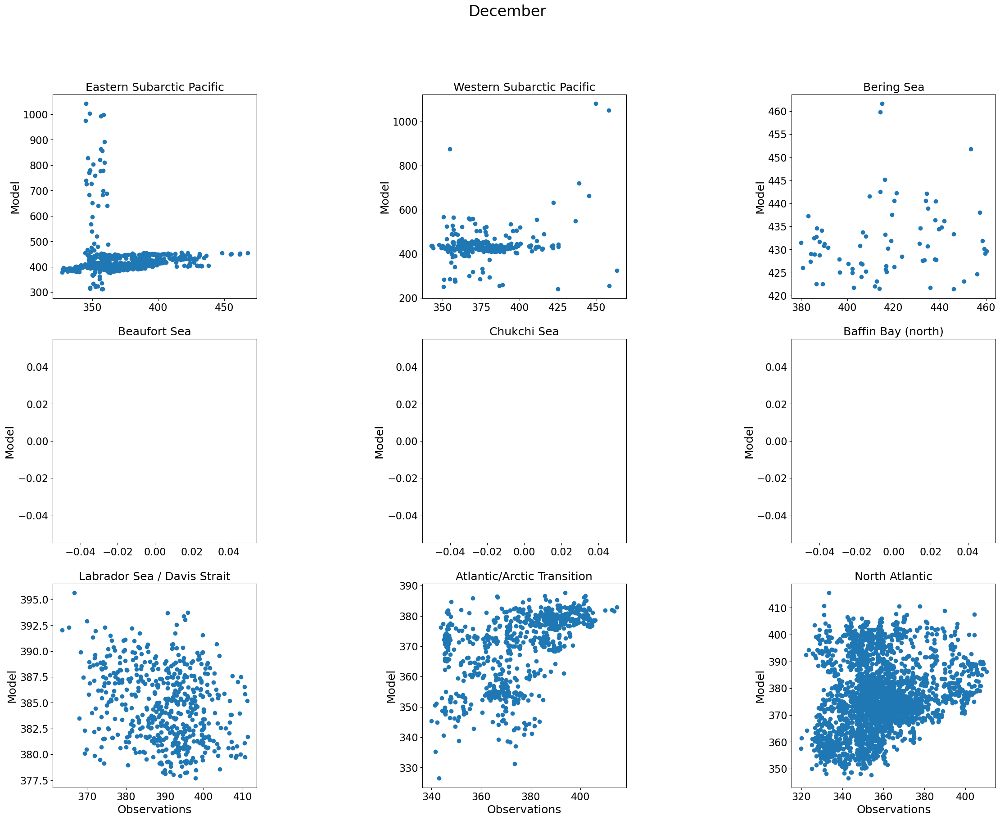

In [18]:
iz = np.arange(10)

months=['January','February','March','April','May','June','July','August','September','October','November','December']
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']

#VJC014l_monthly_pco2

for im, mmon in enumerate(months):
    
    fig, axes = plt.subplots(num=1, clear=True, nrows=3, ncols=3, figsize=(30, 20))
    fig.suptitle(mmon, fontsize=24) # Change month in accordance with what 'im' is set to below
    
    for i, c in enumerate(regions):    
        cx=plt.subplot(3,3,i+1)
        tmaskz=tmask[iz,:,:].flatten()
        ZZ=(np.zeros((10,ny,nx))+regindx).flatten()    # broadcast regions map into a 3D array with same data for each depth
        XOBS=obsPCO2[im,:,:].squeeze().flatten()
        XMOD=modPCO2[im,:,:].squeeze().flatten()
        ii=np.where( ~np.isnan(XOBS) )[0]
        XOBS=XOBS[ii]; XMOD=XMOD[ii]; ZZ=ZZ[ii]; tmaskz=tmaskz[ii];
        jj=np.where( (XOBS>0.) & (ZZ==(i+1)) & (tmaskz==1) )[0]
    
        cx.scatter(XOBS[jj], XMOD[jj], label='Obs')
        if i > 5:
            plt.xlabel("Observations", fontsize=18)
        plt.ylabel("Model", fontsize=18)
        plt.title(c, fontsize=18)
        cx.tick_params(axis='both', labelsize=16)
        cx.set_aspect(1./cx.get_data_ratio())
    
    plt.show()
    #fig.savefig("oxygen_model_obs_month"+str("{:02d}".format(im+1)))
    fig.savefig("/home/fid000/WORK7/ANALYSIS/model_evaluation/FIGURES/PCO2_VJC014l/pco2_month"+str("{:02d}".format(im+1)))

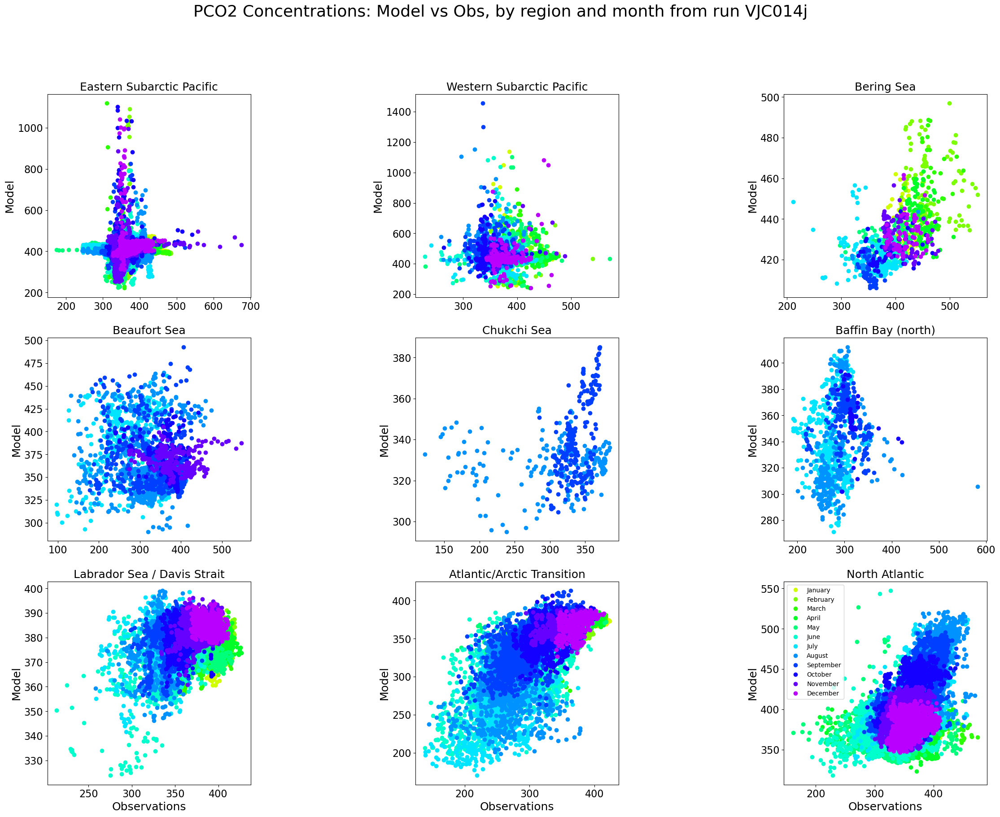

In [9]:
import itertools
fig, axes = plt.subplots(num=1, clear=True, nrows=3, ncols=3, figsize=(30, 20))
fig.suptitle('PCO2 Concentrations: Model vs Obs, by region and month from run VJC014j', fontsize=26)

months=['January','February','March','April','May','June','July','August','September','October','November','December']
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
iz = np.arange(10)
#im = np.arange(12)

for i, c, in enumerate(regions):
    cx=plt.subplot(3,3,i+1)
    colors =itertools.cycle(plt.get_cmap('hsv')(np.linspace(0.2,0.8, 12))) # potential pallettes: hsv, jet, gnuplot2

    
    for im in np.arange(12):
        tmaskz=tmask[iz,:,:].flatten()   
        ZZ=(np.zeros((10,ny,nx))+regindx).flatten()    # broadcast regions map into a 3D array with same data for each depth

        XOBS=obsPCO2[im,:,:].squeeze().flatten()
        XMOD=modPCO2[im,:,:].squeeze().flatten()
        ii=np.where( ~np.isnan(XOBS) )[0]
        XOBS=XOBS[ii]; XMOD=XMOD[ii]; ZZ=ZZ[ii]; tmaskz=tmaskz[ii];
        
        jj=np.where( (XOBS>0.) & (ZZ==(i+1)) & (tmaskz==1) )[0]
        colour = next(colors) 
        plt.plot(XOBS[jj], XMOD[jj], "o", color=colour, markeredgecolor=colour, label=im)
        if i > 5:
            plt.xlabel("Observations", fontsize=18)
        plt.ylabel("Model", fontsize=18)
        plt.title(c, fontsize=18)
        cx.tick_params(axis='both', labelsize=16)
        cx.set_aspect(1./cx.get_data_ratio())
    
plt.legend(labels=['January','February','March','April','May','June','July','August','September','October','November','December'])    
plt.show()
fig.savefig("/home/fid000/WORK7/ANALYSIS/model_evaluation/FIGURES/RegionByColour/PCO2VJC014j_hsv")
#plt.close(fig)    

/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015p_monthly_pco2.nc


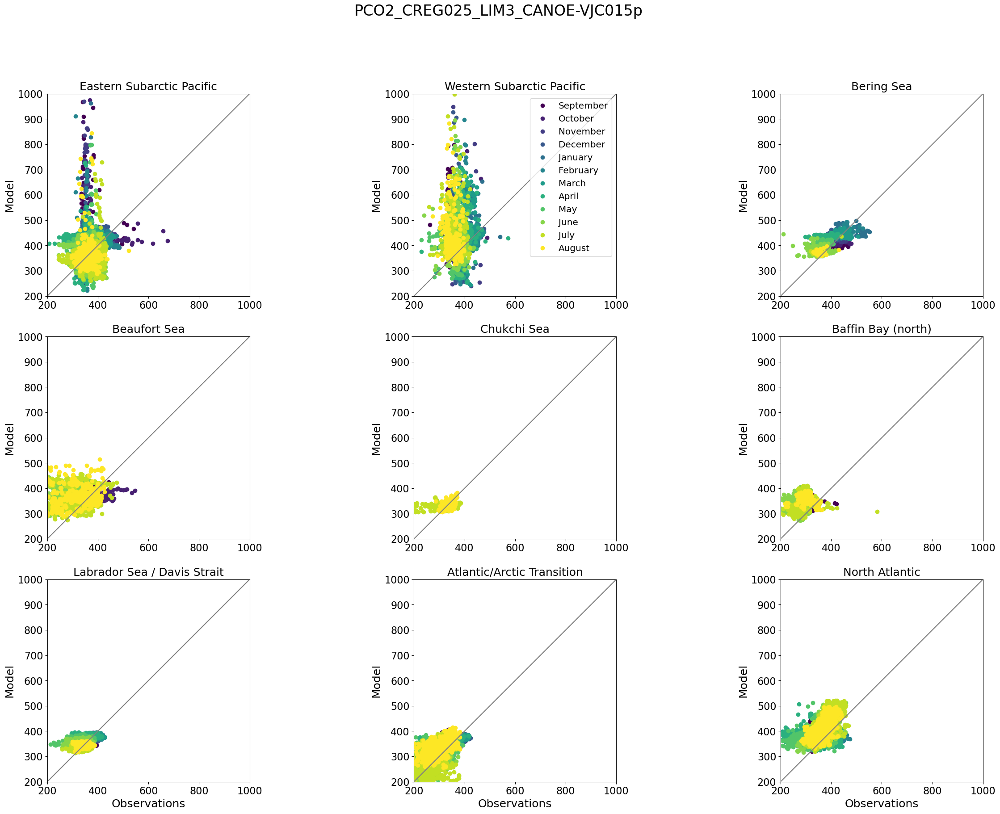

/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:37: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/tmp/ipykernel_814753/1571221555.py:61: DeprecationWarning: `np.bool` is a deprecated alias for the builti

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015q_monthly_pco2.nc


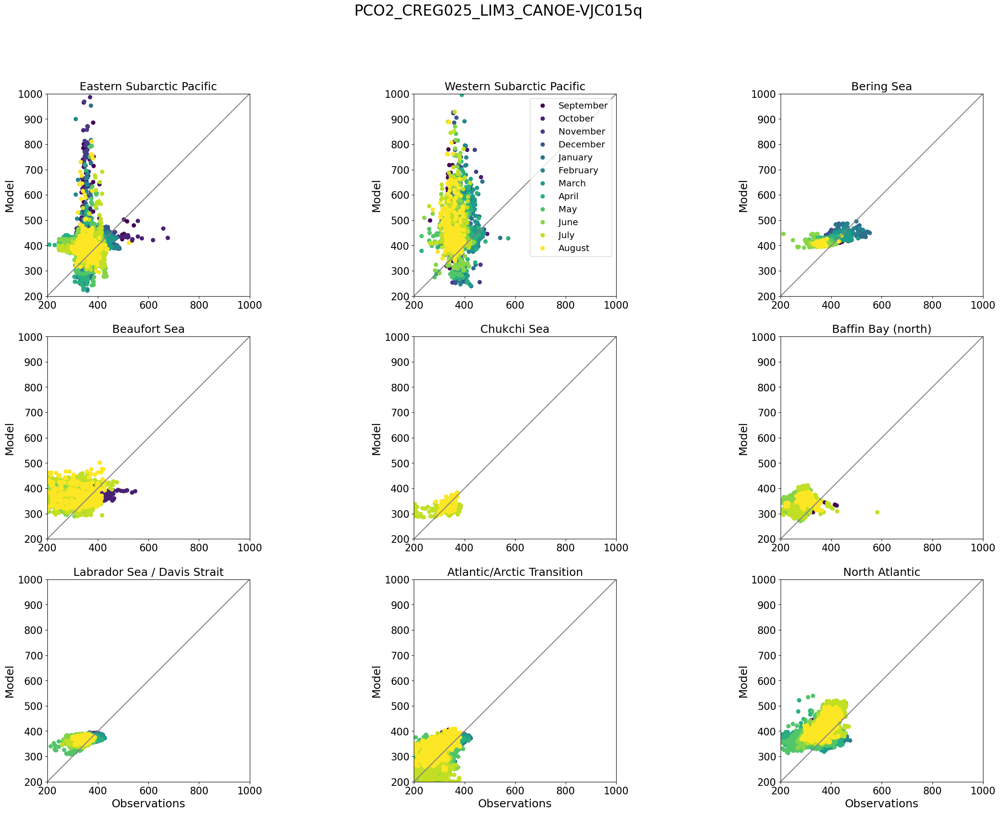

In [5]:
import itertools
fig, axes = plt.subplots(num=1, clear=True, nrows=3, ncols=3, figsize=(30, 20))

months=['September','October','November','December','January','February','March','April','May','June','July','August']
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
iz = np.arange(10)
#variants = ['CREG025_LIM3_CANOE-VJC014l','CREG025_LIM3_CANOE-VJC014t','CREG025_LIM3_CANOE-VJC014w',
#            'CREG025_LIM3_CANOE-VJC014x','CREG025_LIM3_CANOE-VJC014m','CREG025_LIM3_CANOE-VJC014n',
#            'CREG025_LIM3_CANOE-VJC014o','CREG025_LIM3_CANOE-VJC014p','CREG025_LIM3_CANOE-VJC014y',
#            'CREG025_LIM3_CANOE-VJC014q','CREG025_LIM3_CANOE-VJC014z','CREG025_LIM3_CANOE-VJC014r',
#            'CREG025_LIM3_CANOE-VJC014s','CREG025_LIM3_CANOE-VJC014u','CREG025_LIM3_CANOE-VJC014v',
#            'CREG025_LIM3_CANOE-VJC015a','CREG025_LIM3_CANOE-VJC015b','CREG025_LIM3_CANOE-VJC015c',
#            'CREG025_LIM3_CANOE-VJC015d','CREG025_LIM3_CANOE-VJC015e','CREG025_LIM3_CANOE-VJC015f',
#            'CREG025_LIM3_CANOE-VJC015g','CREG025_LIM3_CANOE-VJC015i','CREG025_LIM3_CANOE-VJC015j',
#            'CREG025_LIM3_CANOE-VJC015k','CREG025_LIM3_CANOE-VJC015l','CREG025_LIM3_CANOE-VJCnep01',
#            'CREG025_LIM3_CANOE-VJCsed01','CREG025_LIM3_CANOE-VJCsed02']

variants = ['CREG025_LIM3_CANOE-VJC015p','CREG025_LIM3_CANOE-VJC015q']

for asuff in variants:
    fig, axes = plt.subplots(num=1, clear=True, nrows=3, ncols=3, figsize=(30, 20))
    runid = str(asuff)
    data_all=np.zeros((12,ny,nx))
    fig.suptitle('PCO2_'+asuff, fontsize=24)
    flist = glob.glob("/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/"+runid+"_monthly_pco2.nc")
    flist.sort()
    ifile = 0
    for i, c, in enumerate(regions):
        cx=plt.subplot(3,3,i+1)
        colors =itertools.cycle(plt.get_cmap('viridis')(np.linspace(0,1, 12))) # potential pallettes: hsv, jet, gnuplot
        
        for im in np.arange(9,12):
            if im >= 0:
                
                filein = flist[ifile]
                data = Dataset(filein, "r", format="NETCDF4")
                modPCO2 = data.variables['pco2'][:]
                tmaskz=tmask[iz,:,:].flatten()   
                ZZ=(np.zeros((10,ny,nx))+regindx).flatten()    # broadcast regions map into a 3D array with same data for each depth

                XOBS=obsPCO2[im,:,:].squeeze().flatten()
                XMOD=modPCO2[im,:,:].squeeze().flatten()
                ii=np.where( ~np.isnan(XOBS) )[0]
                XOBS=XOBS[ii]; XMOD=XMOD[ii]; ZZ=ZZ[ii]; tmaskz=tmaskz[ii];

                jj=np.where( (XOBS>0.) & (ZZ==(i+1)) & (tmaskz==1) )[0]
                colour = next(colors) 
                plt.plot(XOBS[jj], XMOD[jj], "o", color=colour, markeredgecolor=colour, label=im)
            if i > 5:
                plt.xlabel("Observations", fontsize=18)
            plt.ylabel("Model", fontsize=18)
            plt.title(c, fontsize=18)
            #plt.axis('square')
            cx.tick_params(axis='both', labelsize=16)
            cx.set_aspect(1./cx.get_data_ratio())
        for im in np.arange(0,9):
            if im >= 0:
                filein = flist[ifile]
                print(filein)
                data = Dataset(filein, "r", format="NETCDF4")
                modPCO2 = data.variables['pco2'][:]
                tmaskz=tmask[iz,:,:].flatten()   
                ZZ=(np.zeros((10,ny,nx))+regindx).flatten()    # broadcast regions map into a 3D array with same data for each depth

                XOBS=obsPCO2[im,:,:].squeeze().flatten()
                XMOD=modPCO2[im,:,:].squeeze().flatten()
                ii=np.where( ~np.isnan(XOBS) )[0]
                XOBS=XOBS[ii]; XMOD=XMOD[ii]; ZZ=ZZ[ii]; tmaskz=tmaskz[ii];

                jj=np.where( (XOBS>0.) & (ZZ==(i+1)) & (tmaskz==1) )[0]
                colour = next(colors) 
                plt.plot(XOBS[jj], XMOD[jj], "o", color=colour, markeredgecolor=colour, label=im)

            if i > 5:
                plt.xlabel("Observations", fontsize=18)

            plt.ylabel("Model", fontsize=18)
            plt.title(c, fontsize=18)
            plt.xlim([200, 1000]); plt.ylim([200,1000])
            cx.tick_params(axis='both', labelsize=16)
            cx.set_aspect(1./cx.get_data_ratio())
        cx.plot([0, 1], [0, 1], color='grey', transform=cx.transAxes)
        if i == 1:
            plt.legend(labels=['September','October','November','December','January','February','March','April','May','June','July','August'],
                       fontsize='x-large')
    
    plt.show()
    fig.savefig("/home/fid000/WORK7/ANALYSIS/model_evaluation/FIGURES/Books/PCO2/PCO2_"+runid)
    #plt.close(fig)    

CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0


/tmp/ipykernel_432318/1517120256.py:45: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]


/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014t
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014q
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

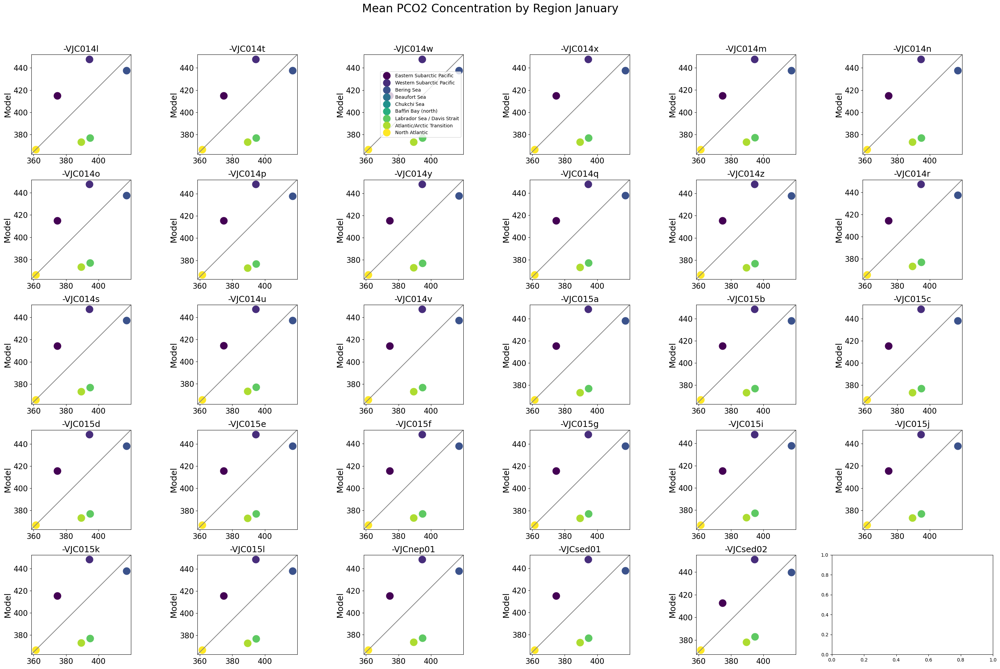

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

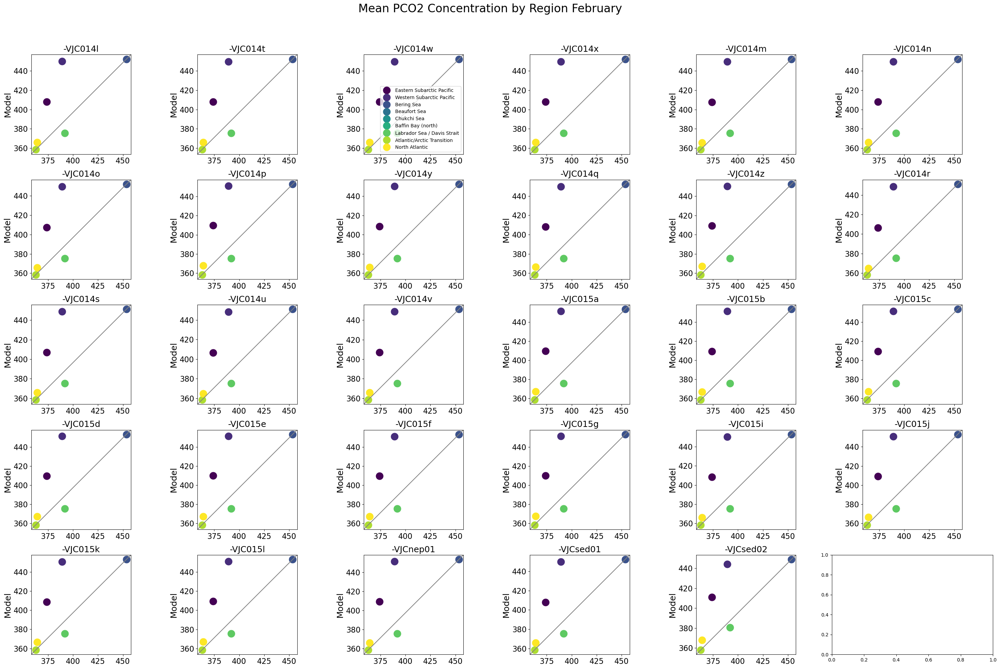

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

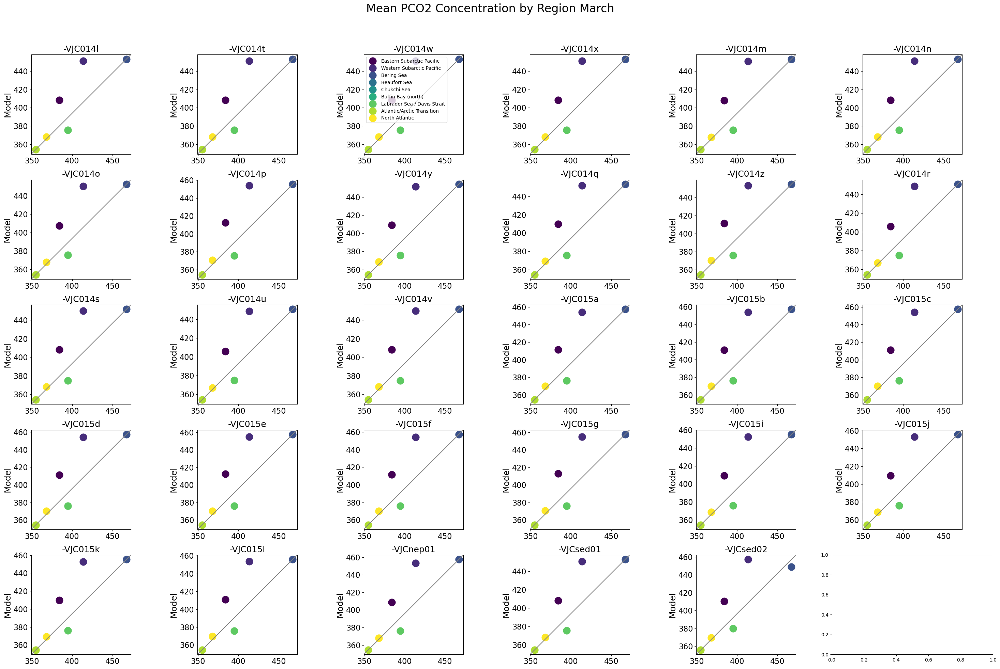

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

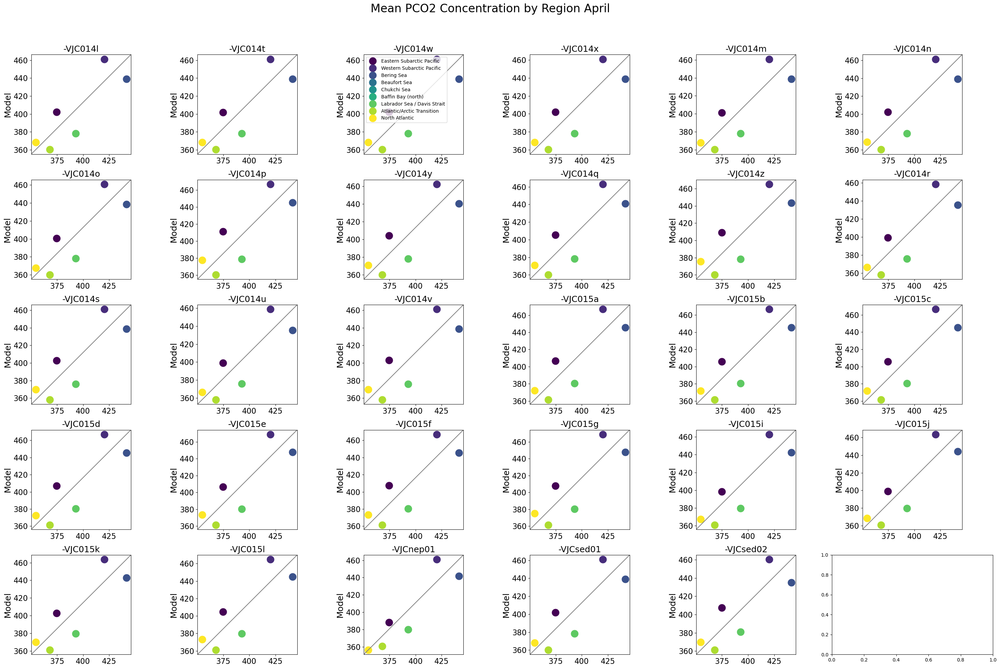

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014q
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

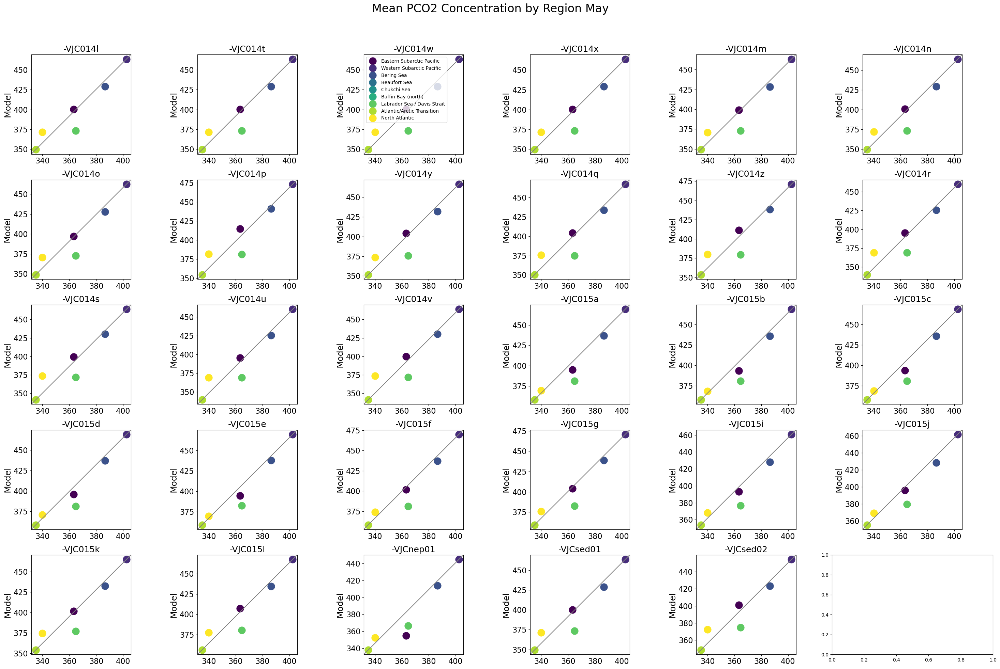

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

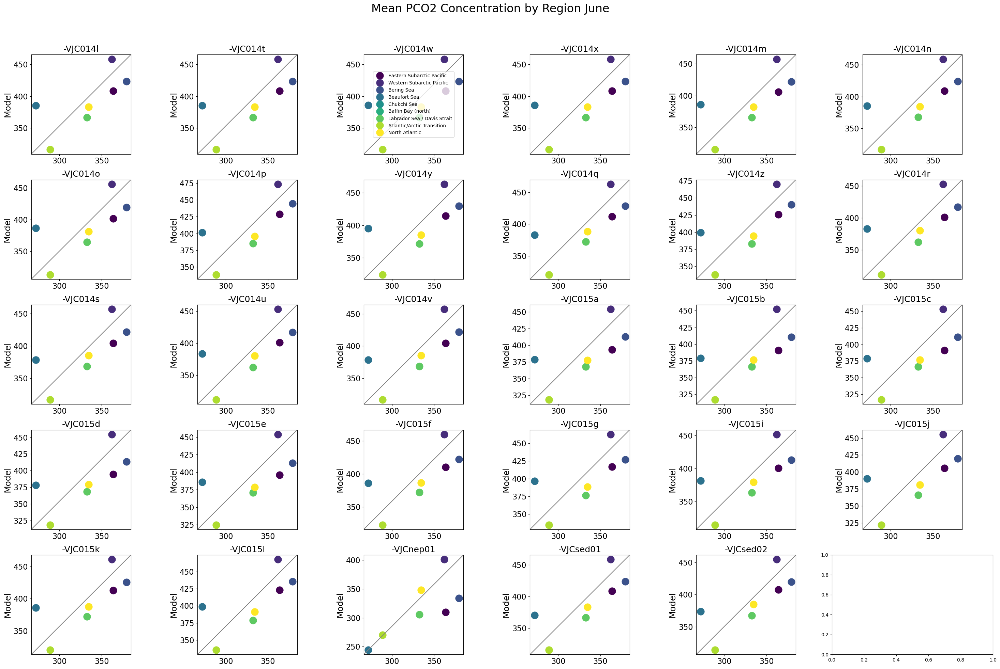

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

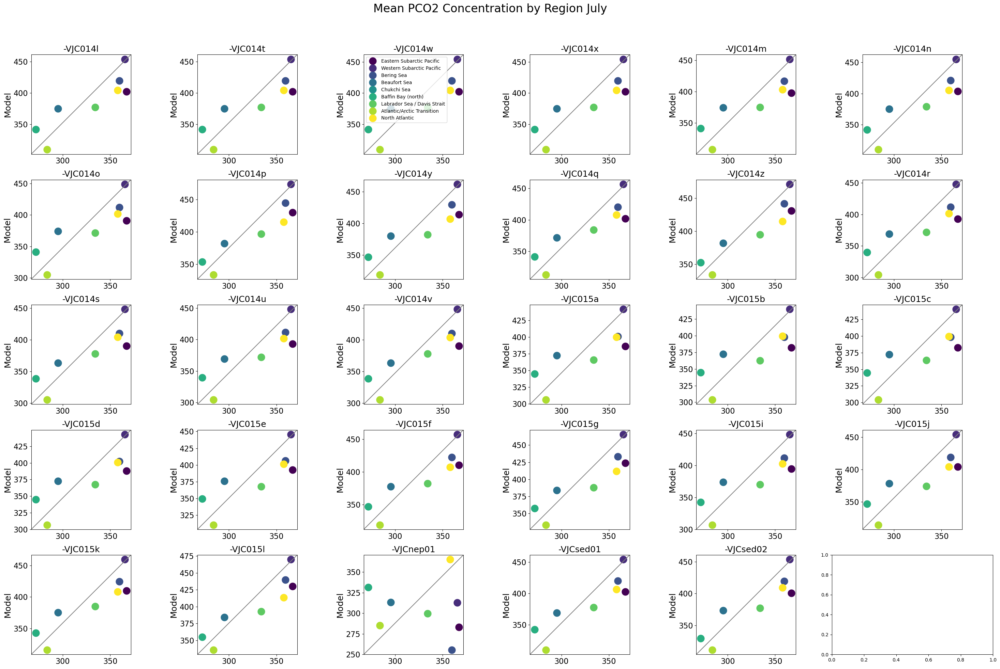

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

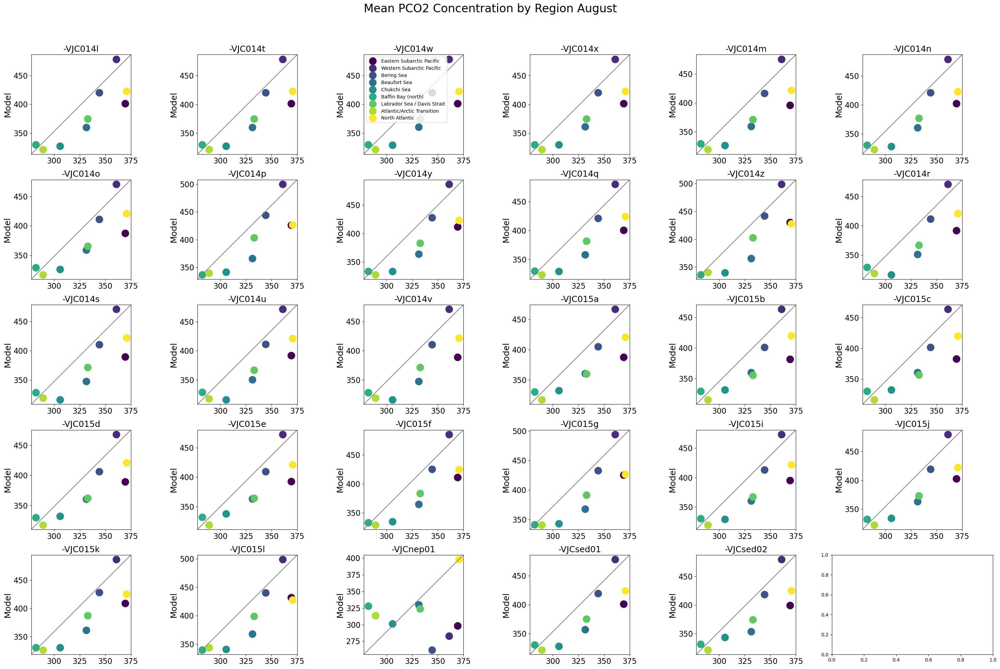

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014q
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

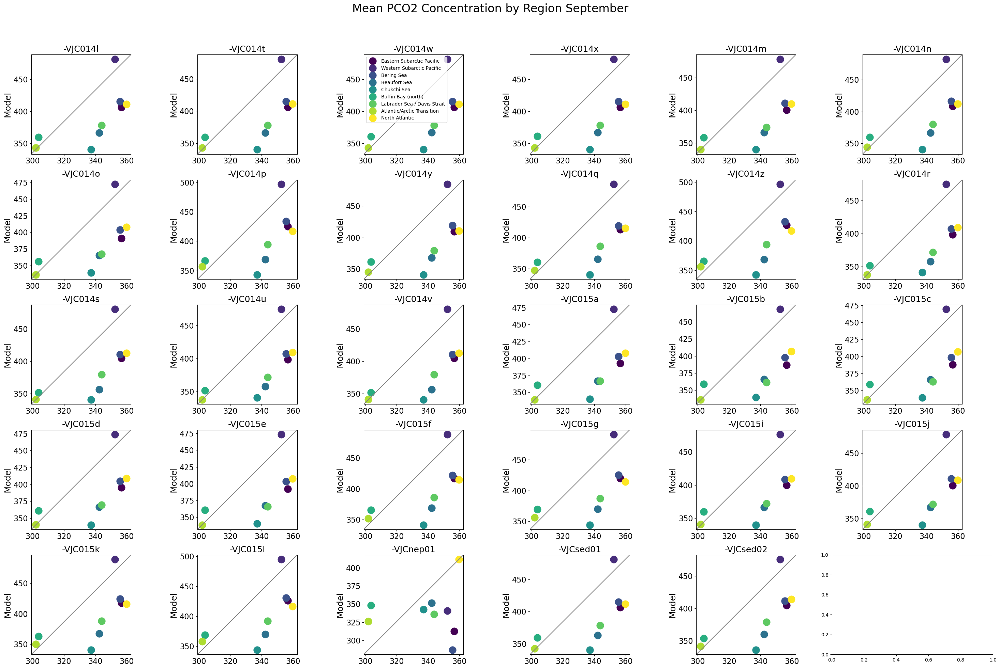

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

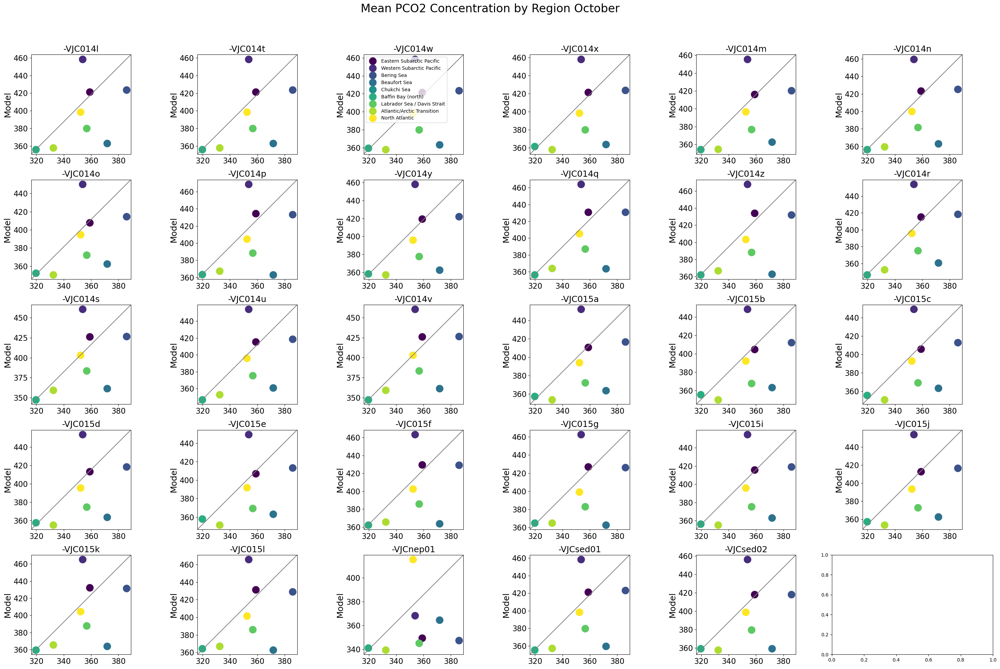

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014q
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

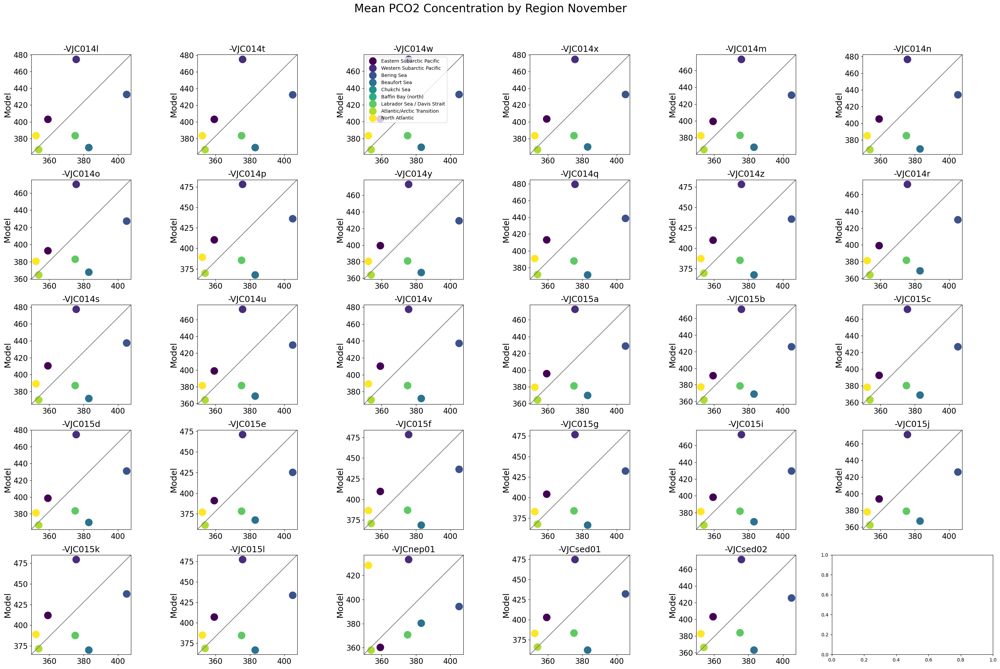

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

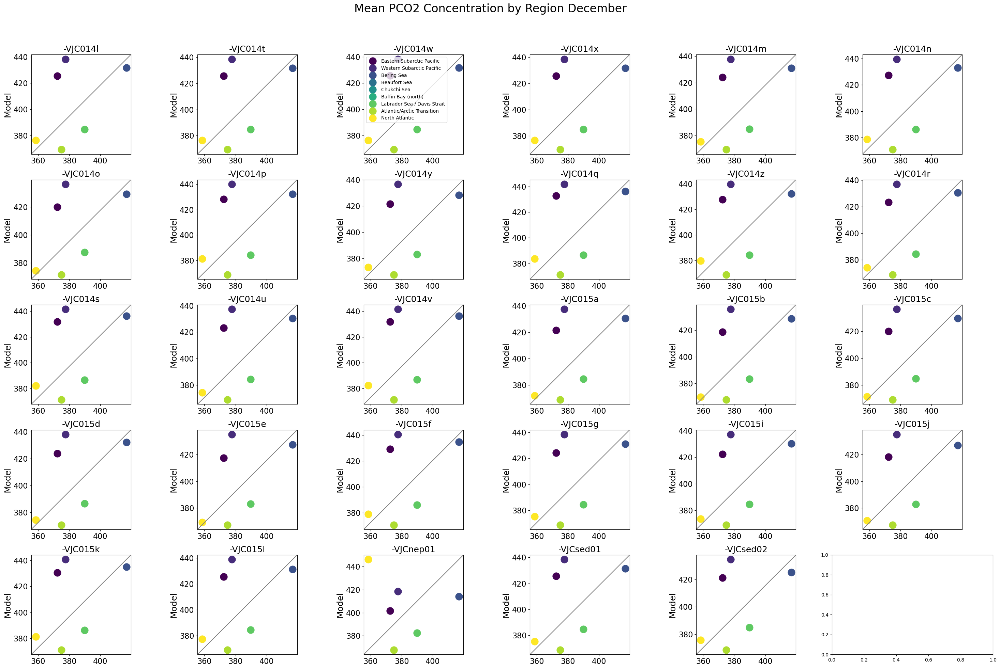

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed02_monthly_pco2.nc


In [86]:
#fig, axes = plt.subplots(num=1, clear=True, nrows=6, ncols=5, figsize=(30, 20))
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
import itertools
iz = np.arange(10)

months=['January','February','March','April','May','June','July','August','September','October','November','December']
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
variants = ['-VJC014l','-VJC014t','-VJC014w',
            '-VJC014x','-VJC014m','-VJC014n',
            '-VJC014o','-VJC014p','-VJC014y',
            '-VJC014q','-VJC014z','-VJC014r',
            '-VJC014s','-VJC014u','-VJC014v',
            '-VJC015a','-VJC015b','-VJC015c',
            '-VJC015d','-VJC015e','-VJC015f',
            '-VJC015g','-VJC015i','-VJC015j',
            '-VJC015k','-VJC015l','-VJCnep01',
            '-VJCsed01','-VJCsed02']


for im, mmon in enumerate(months):
    
    fig, axes = plt.subplots(num=1, clear=True, nrows=5, ncols=6, figsize=(30, 20))
    fig.suptitle('Mean PCO2 Concentration by Region '+mmon, fontsize=24) # Change month in accordance with what 'im' is set to below
    
    for a, asuff in enumerate(variants):
        cx=plt.subplot(5,6, a+1)
        runid = str('CREG025_LIM3_CANOE'+asuff)
        print(runid)
        data_all=np.zeros((12,ny,nx))
        flist = glob.glob("/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/"+runid+"_monthly_pco2.nc")
        flist.sort()
        print(flist)
        ifile = 0
        colors =itertools.cycle(plt.get_cmap('viridis')(np.linspace(0,1, 9))) # potential pallettes: hsv, jet, gnuplot
            
        for i, c in enumerate(regions): 
            
            if i >= 0:
                
                #ifile=ifile+1
                print(ifile)
                filein = flist[ifile]
                #print(filein)
                data = Dataset(filein, "r", format="NETCDF4")
                modPCO2 = data.variables['pco2'][:]

                tmaskz=tmask[iz,:,:].flatten()
                ZZ=(np.zeros((10,ny,nx))+regindx).flatten()    # broadcast regions map into a 3D array with same data for each depth
                XOBS=obsPCO2[im,:,:].squeeze().flatten()
                XMOD=modPCO2[im,:,:].squeeze().flatten()
                ii=np.where( ~np.isnan(XOBS) )[0]
                XOBS=XOBS[ii]; XMOD=XMOD[ii]; ZZ=ZZ[ii]; tmaskz=tmaskz[ii];
                jj=np.where( (XOBS>0.) & (ZZ==(i+1)) & (tmaskz==1) )[0]
                
                
                #X=O3[irg[0]]; Y=M3[irg[0]]
                #omn3[i]=np.mean(X[X<=1.]); mmn3[i]=np.mean(Y[Y<=1.])
                
                
                
                XOBS=np.mean(XOBS[jj]); XMOD=np.mean(XMOD[jj])
                
                colour = next(colors) 
                #plt.plot(XOBS[jj], XMOD[jj], "o", color=colour, markeredgecolor=colour, label=regions)
                plt.plot(XOBS, XMOD, "o", color=colour, markeredgecolor=colour, markersize=15, label=regions)
                print(filein)

            #if i > 5:
            #    plt.xlabel("Observations", fontsize=18)
            plt.ylabel("Model", fontsize=18)
            plt.title(asuff, fontsize=18)
            cx.tick_params(axis='both', labelsize=16)
            cx.set_aspect(1./cx.get_data_ratio())
        cx.plot([0, 1], [0, 1], color='grey', transform=cx.transAxes)
        if a == 2:
            plt.legend(labels=['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic'],
                       fontsize='medium')
    plt.tight_layout(rect=(0,0,1,0.95), w_pad=0)
    plt.show()
    print(filein)
    #fig.savefig("oxygen_model_obs_month"+str("{:02d}".format(im+1)))
    fig.savefig("/home/fid000/WORK7/ANALYSIS/model_evaluation/FIGURES/test/pco2_month"+str("{:02d}".format(im+1)))

CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0


/tmp/ipykernel_547810/433455208.py:47: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]


/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014t
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014t_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

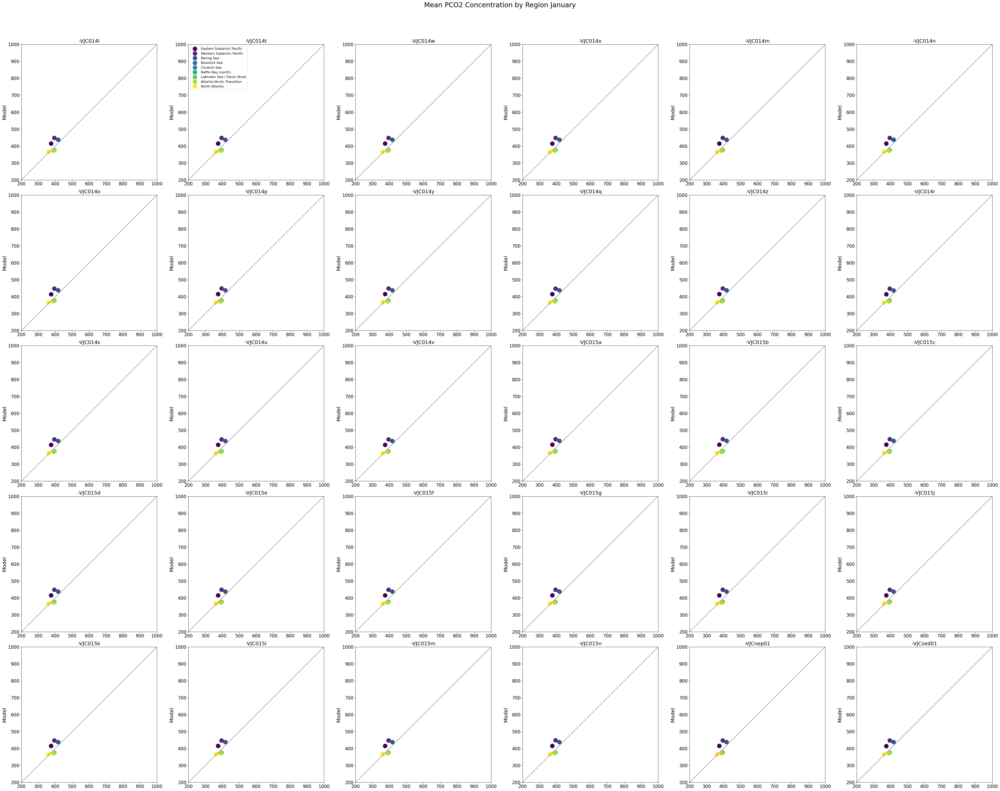

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

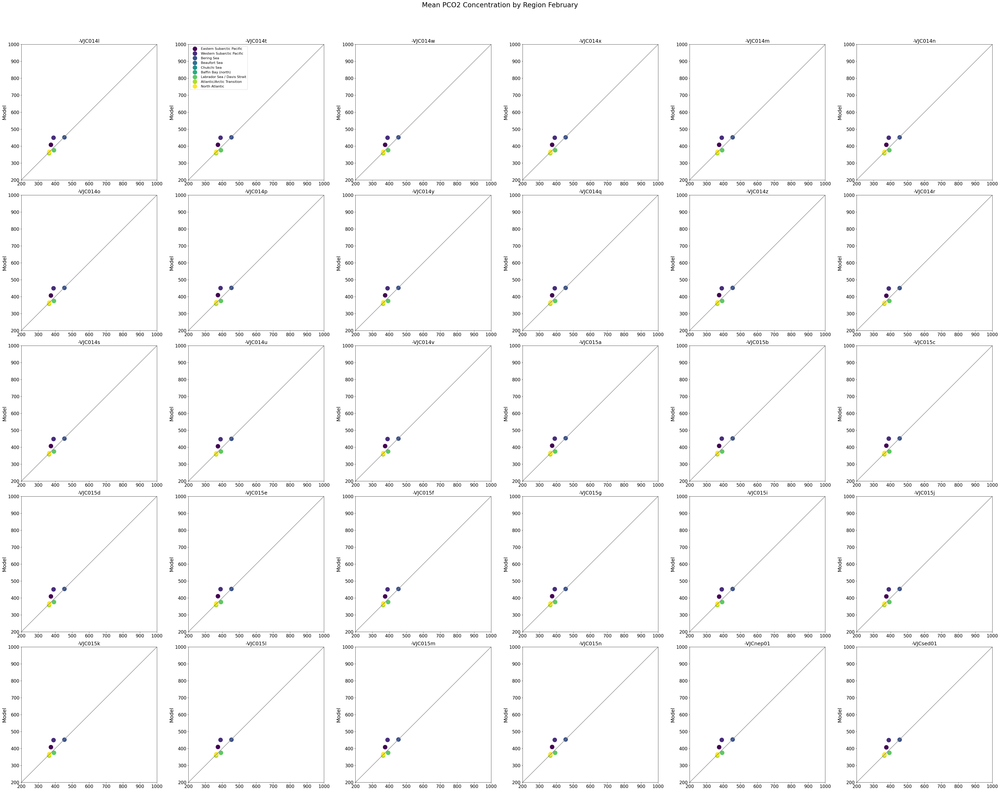

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

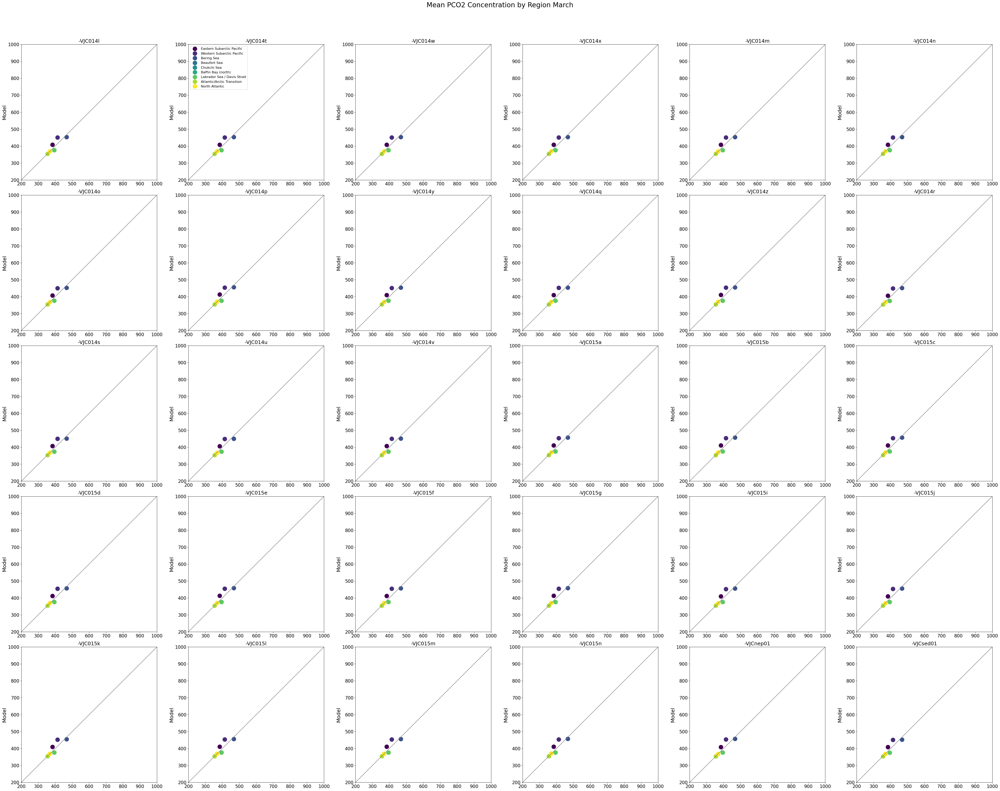

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

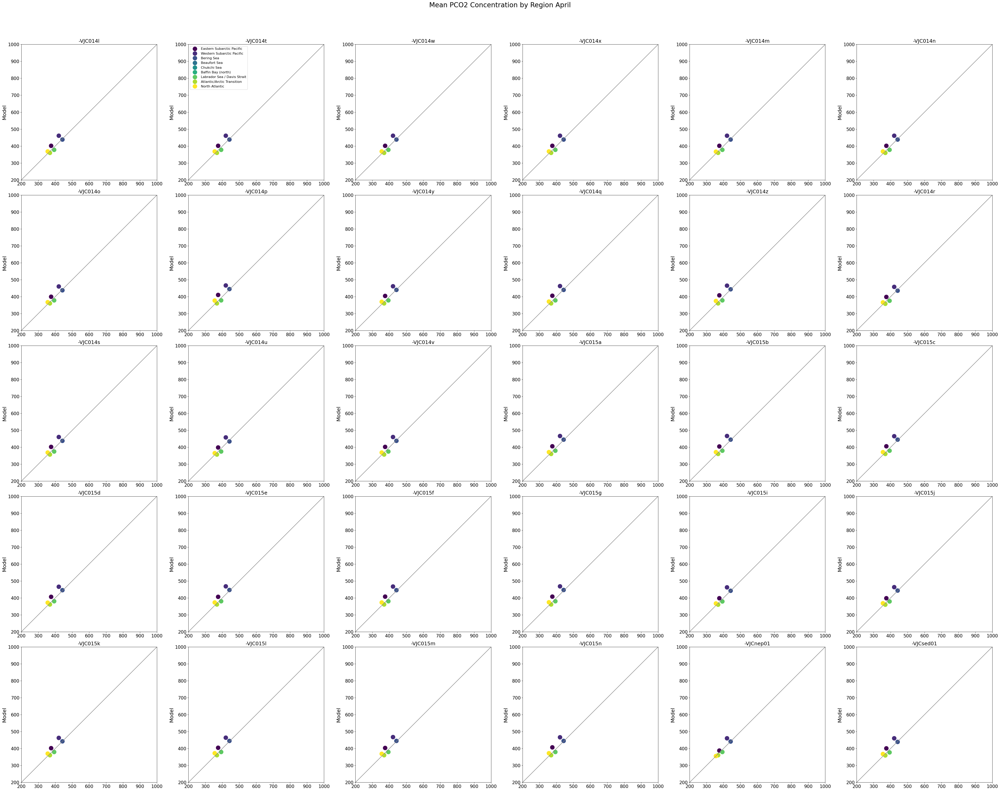

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

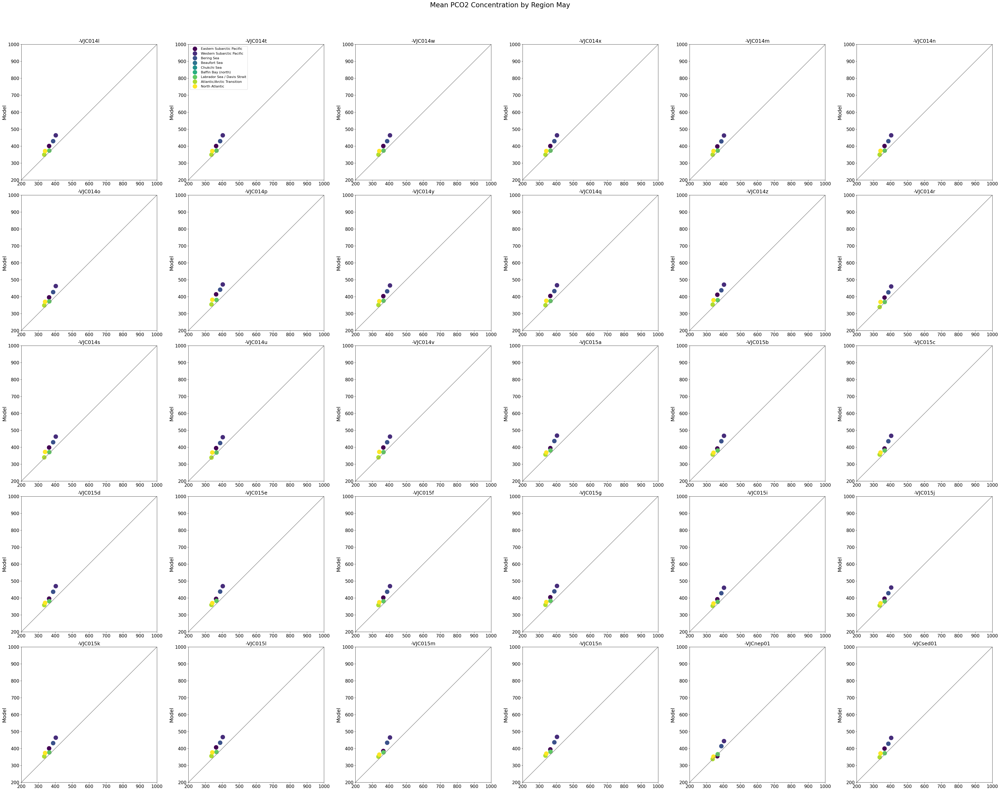

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

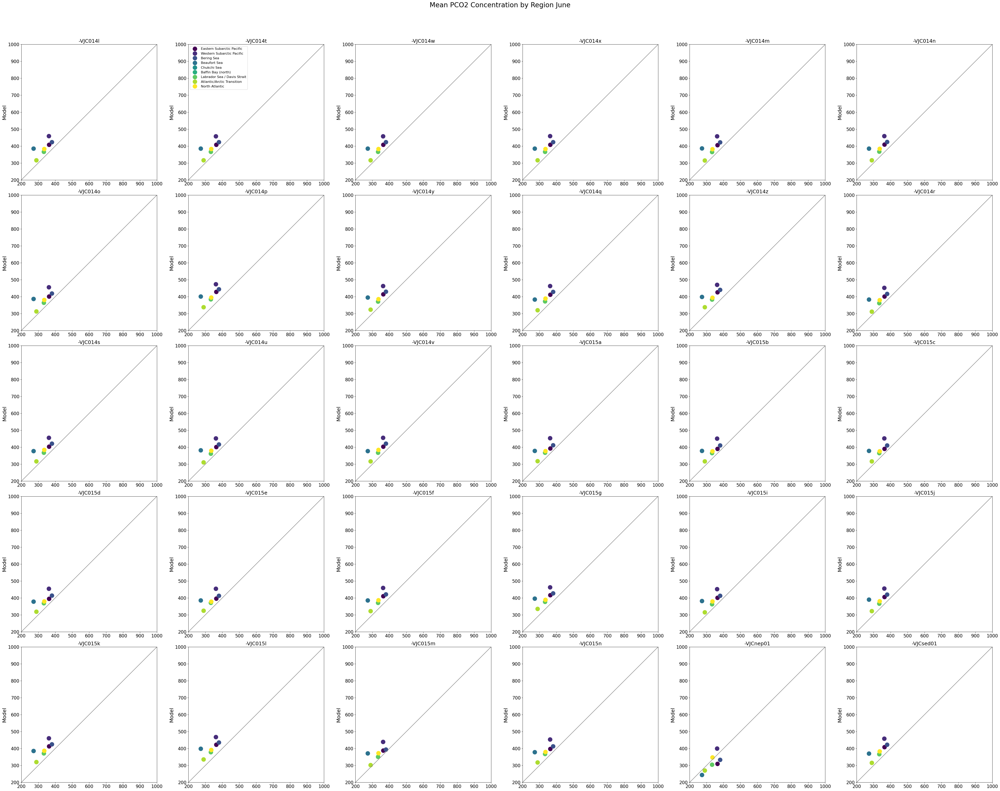

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

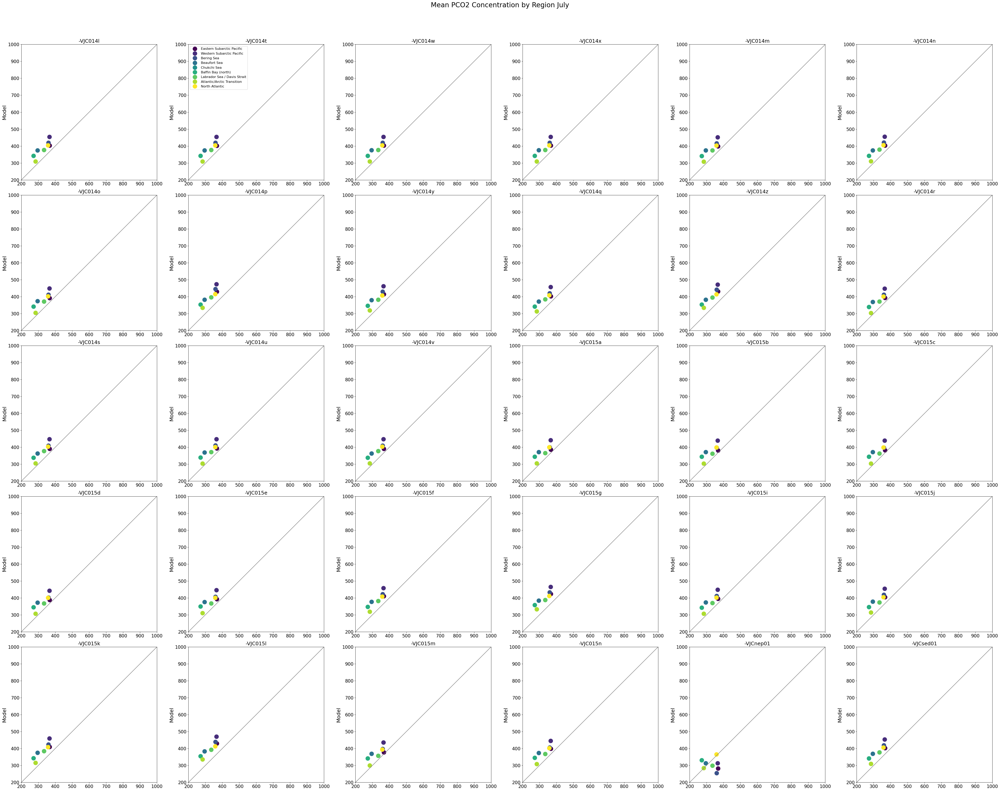

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

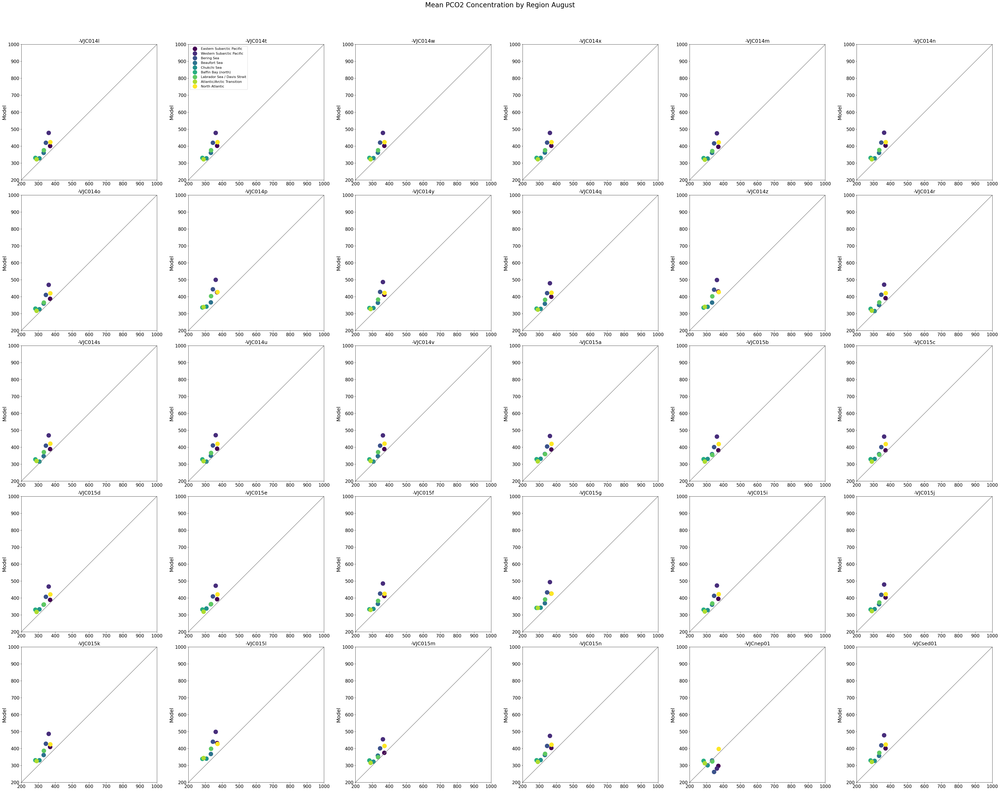

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014q
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014q_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015c
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015c_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

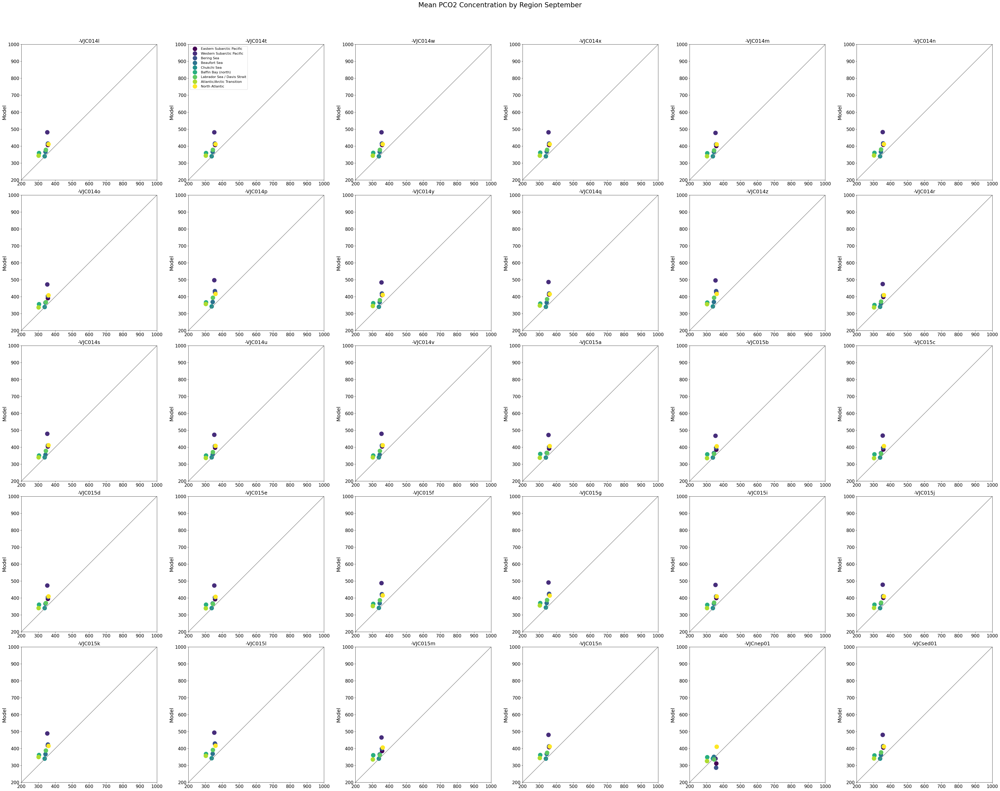

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

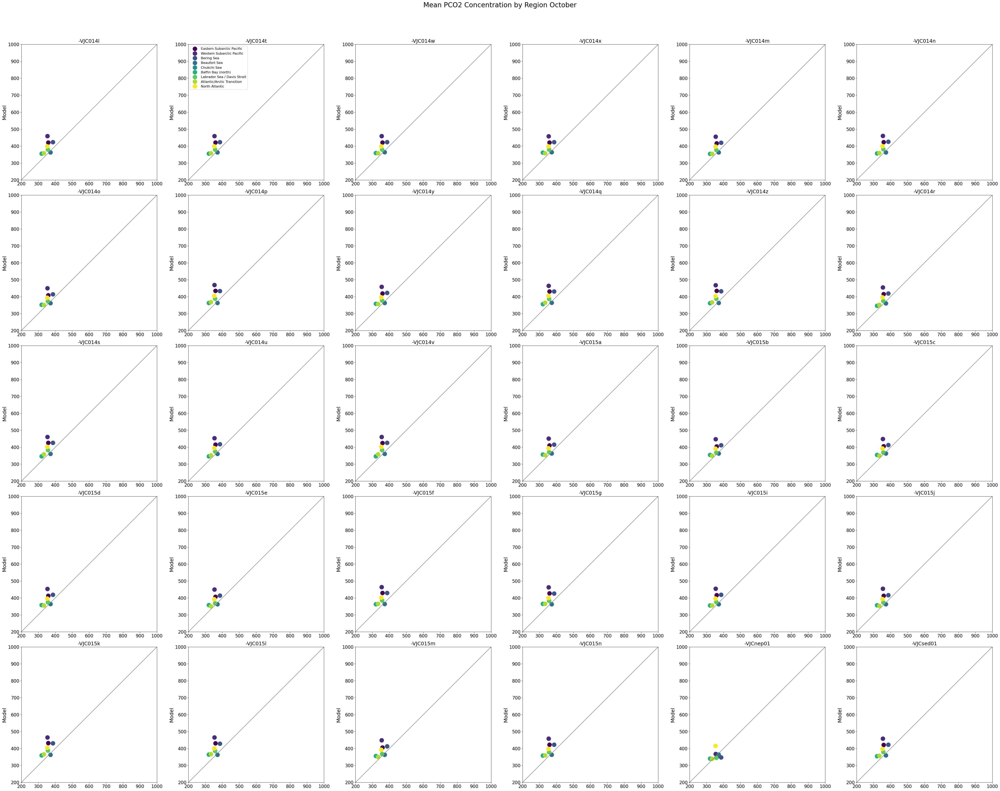

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014q
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CRE

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

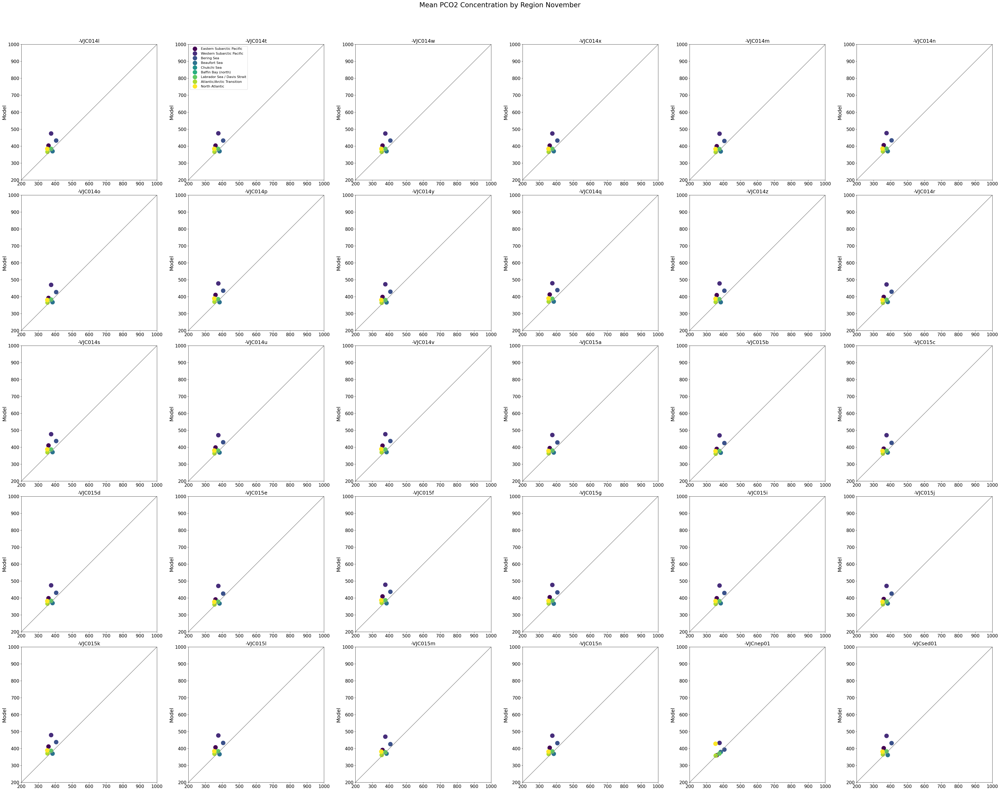

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014l
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014l_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014p_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC014y
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC014y_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015a_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015b
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015b_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015j_monthly_pco2.nc
CREG025_LIM3_CANOE-VJC015k
['/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc']
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJC015k_monthly_pco2.nc
0
/gpfs/fs7/dfo/hpcmc/comda/stod000/C

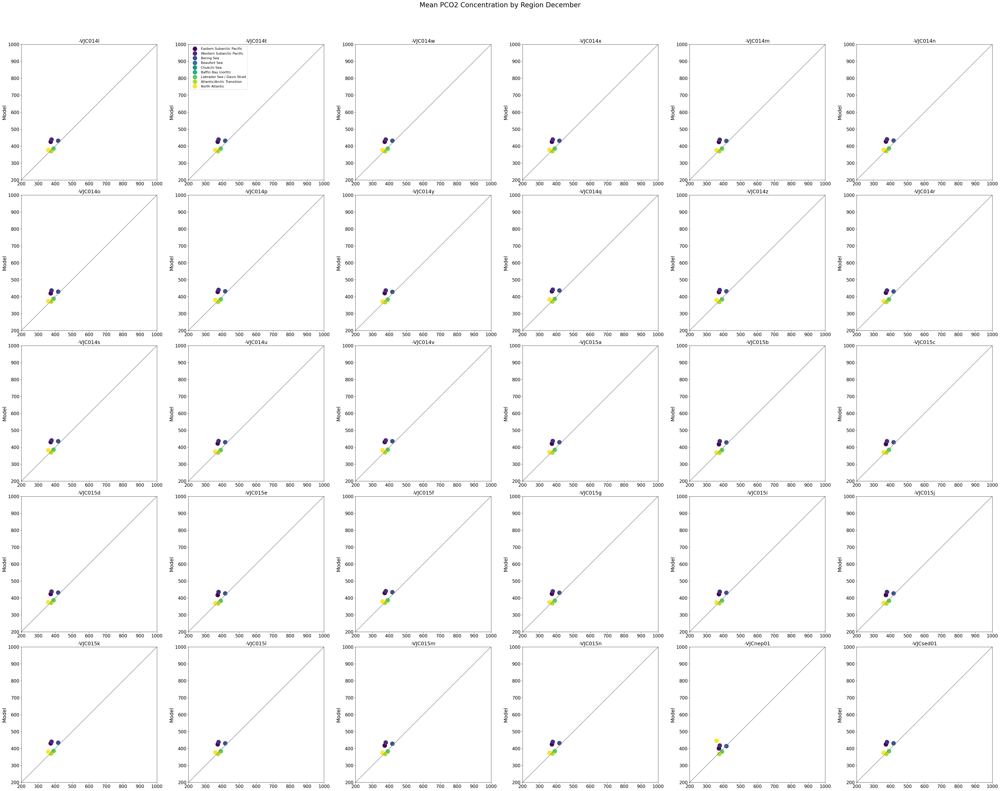

/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/CREG025_LIM3_CANOE-VJCsed01_monthly_pco2.nc


In [10]:
# July

#fig, axes = plt.subplots(num=1, clear=True, nrows=6, ncols=5, figsize=(30, 20))
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
import itertools
iz = np.arange(10)

months=['January','February','March','April','May','June','July','August','September','October','November','December']
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
variants = ['-VJC014l','-VJC014t','-VJC014w',
            '-VJC014x','-VJC014m','-VJC014n',
            '-VJC014o','-VJC014p','-VJC014y',
            '-VJC014q','-VJC014z','-VJC014r',
            '-VJC014s','-VJC014u','-VJC014v',
            '-VJC015a','-VJC015b','-VJC015c',
            '-VJC015d','-VJC015e','-VJC015f',
            '-VJC015g','-VJC015i','-VJC015j',
            '-VJC015k','-VJC015l','-VJC015m',
            '-VJC015n','-VJCnep01','-VJCsed01']


for im, mmon in enumerate(months):
    
    fig, axes = plt.subplots(num=1, clear=True, nrows=5, ncols=6, figsize=(50, 40))
    fig.suptitle('Mean PCO2 Concentration by Region '+mmon, fontsize=24) 
    
    for a, asuff in enumerate(variants):
        cx=plt.subplot(5,6, a+1)
        runid = str('CREG025_LIM3_CANOE'+asuff)
        print(runid)
        data_all=np.zeros((12,ny,nx))
        flist = glob.glob("/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/"+runid+"_monthly_pco2.nc")
        flist.sort()
        print(flist)
        ifile = 0
        colors =itertools.cycle(plt.get_cmap('viridis')(np.linspace(0,1, 9))) # potential pallettes: hsv, jet, gnuplot
            
        for i, c in enumerate(regions): 
            
            if i >= 0:
                
                #ifile=ifile+1
                print(ifile)
                filein = flist[ifile]
                #print(filein)
                data = Dataset(filein, "r", format="NETCDF4")
                modPCO2 = data.variables['pco2'][:]

                tmaskz=tmask[iz,:,:].flatten()
                ZZ=(np.zeros((10,ny,nx))+regindx).flatten()    # broadcast regions map into a 3D array with same data for each depth
                XOBS=obsPCO2[im,:,:].squeeze().flatten()
                XMOD=modPCO2[im,:,:].squeeze().flatten()
                ii=np.where( ~np.isnan(XOBS) )[0]
                XOBS=XOBS[ii]; XMOD=XMOD[ii]; ZZ=ZZ[ii]; tmaskz=tmaskz[ii];
                jj=np.where( (XOBS>0.) & (ZZ==(i+1)) & (tmaskz==1) )[0]
                
                
                #X=O3[irg[0]]; Y=M3[irg[0]]
                #omn3[i]=np.mean(X[X<=1.]); mmn3[i]=np.mean(Y[Y<=1.])
                
                
                
                XOBS=np.mean(XOBS[jj]); XMOD=np.mean(XMOD[jj])
                
                colour = next(colors) 
                #plt.plot(XOBS[jj], XMOD[jj], "o", color=colour, markeredgecolor=colour, label=regions)
                plt.plot(XOBS, XMOD, "o", color=colour, markeredgecolor=colour, markersize=15, label=regions)
                print(filein)

            #if i > 5:
            #    plt.xlabel("Observations", fontsize=18)
            plt.ylabel("Model", fontsize=18)
            plt.title(asuff, fontsize=18)
            plt.xlim([200, 1000]); plt.ylim([200,1000])
            cx.tick_params(axis='both', labelsize=16)
            cx.set_aspect(1./cx.get_data_ratio())
            if a ==1:
                plt.legend(labels=['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic'],
                           fontsize='large')
        cx.plot([0, 1], [0, 1], color='grey', transform=cx.transAxes)
        
            
    plt.tight_layout(rect=(0,0,1,0.95), w_pad=0)
    plt.show()
    print(filein)
    #fig.savefig("oxygen_model_obs_month"+str("{:02d}".format(im+1)))
    fig.savefig("/home/fid000/WORK7/ANALYSIS/model_evaluation/FIGURES/Means/PCO2/pco2_month"+str("{:02d}".format(im+1)))

/tmp/ipykernel_886053/1877404499.py:41: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]


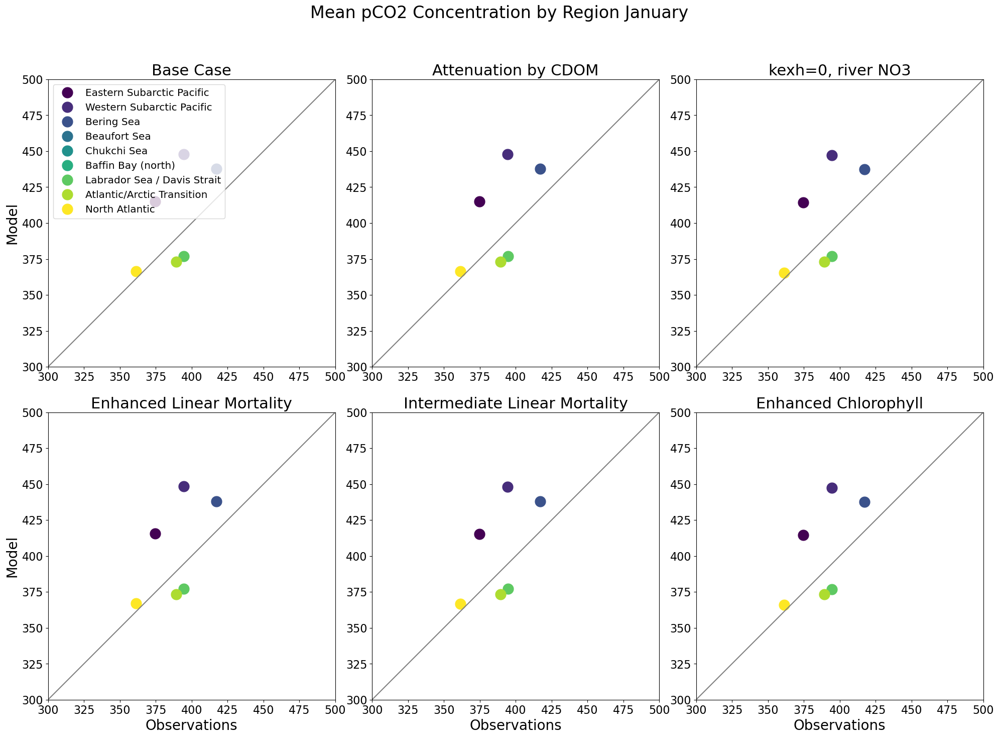

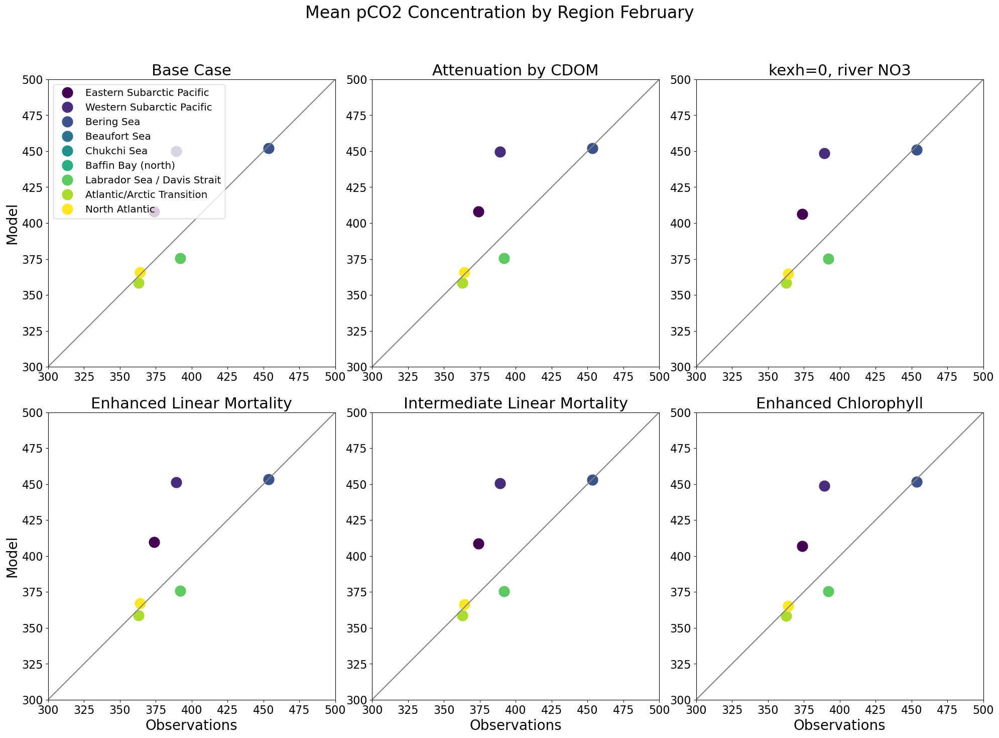

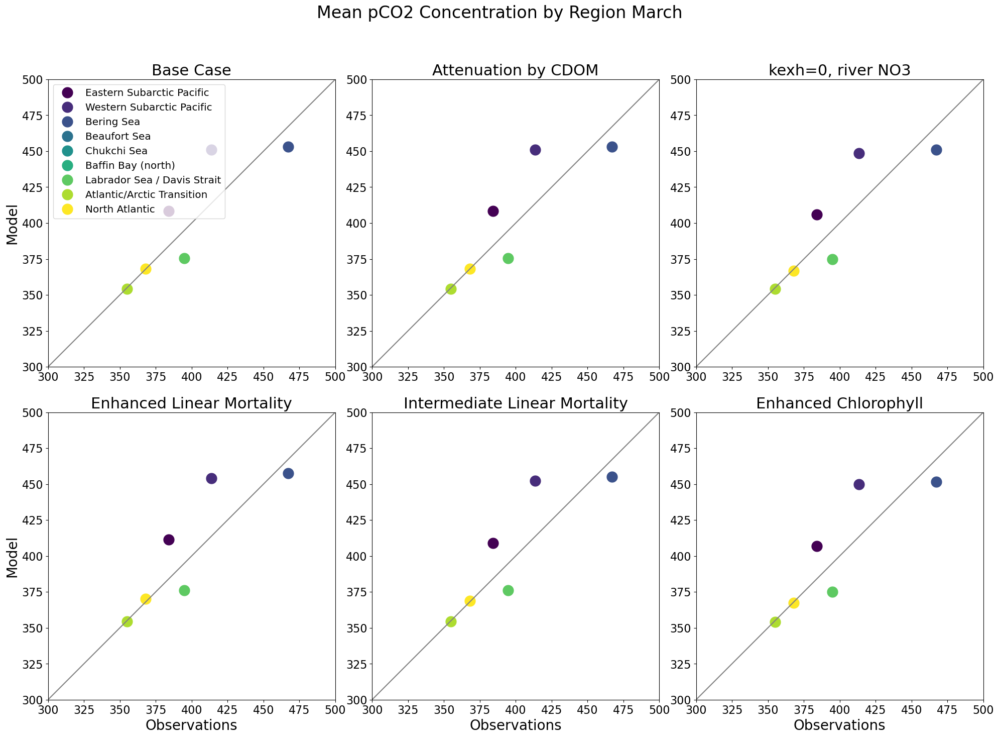

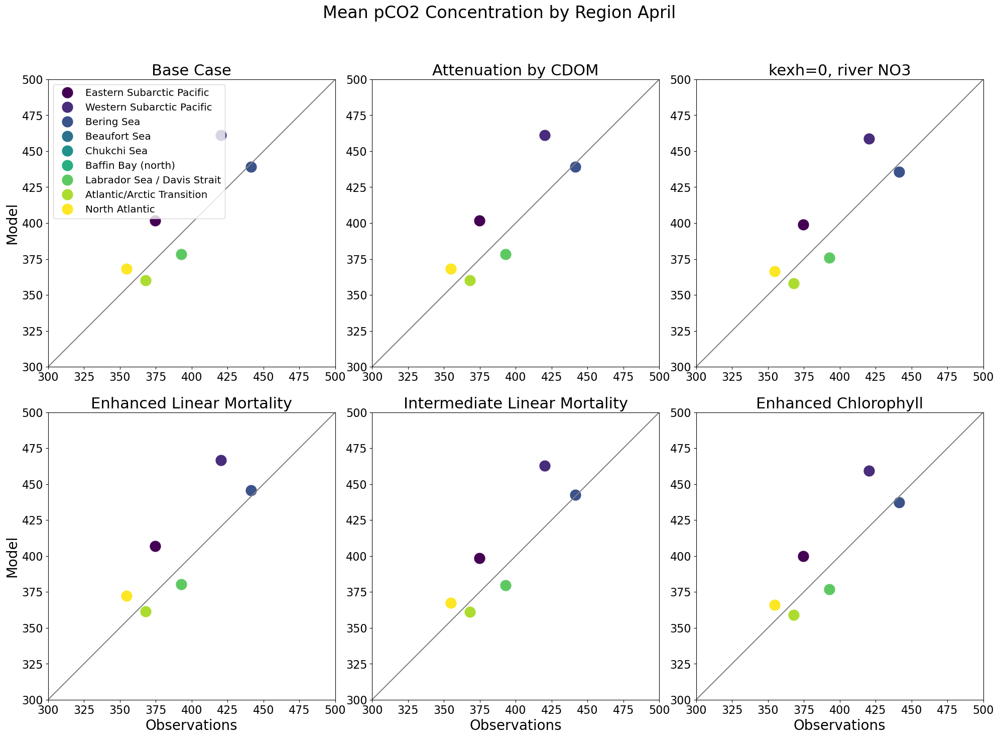

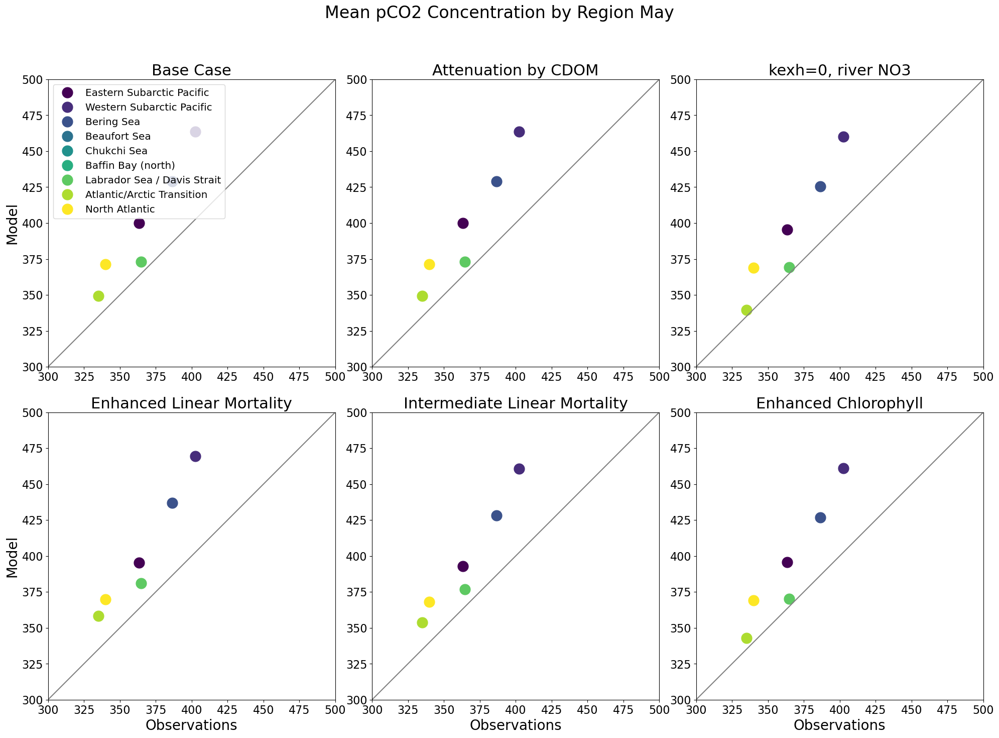

...

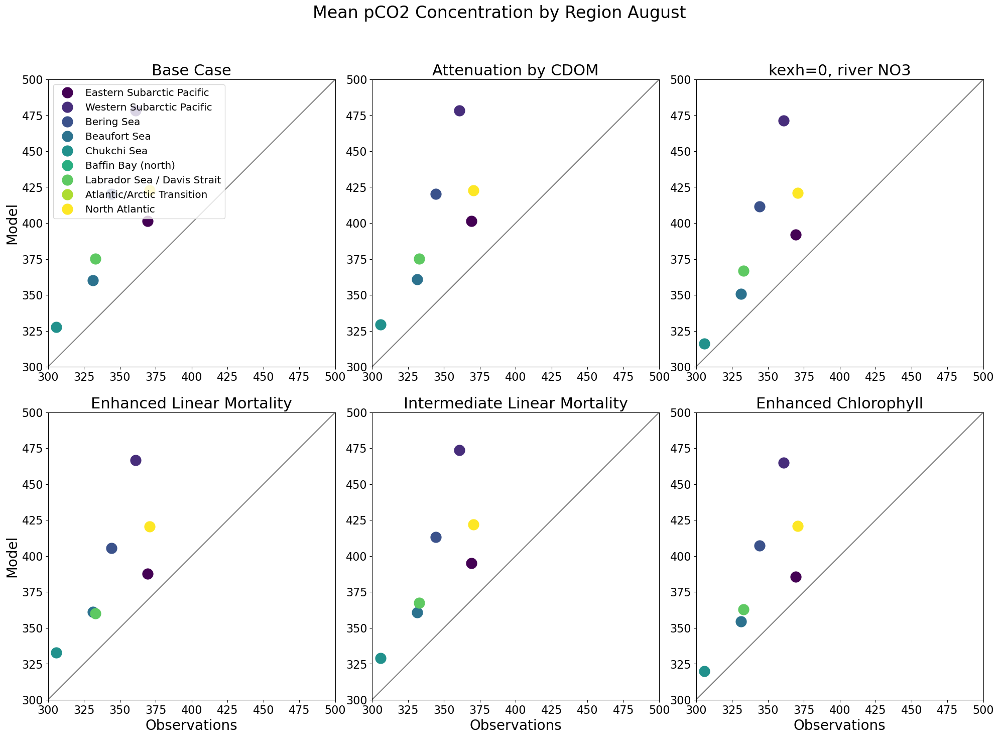

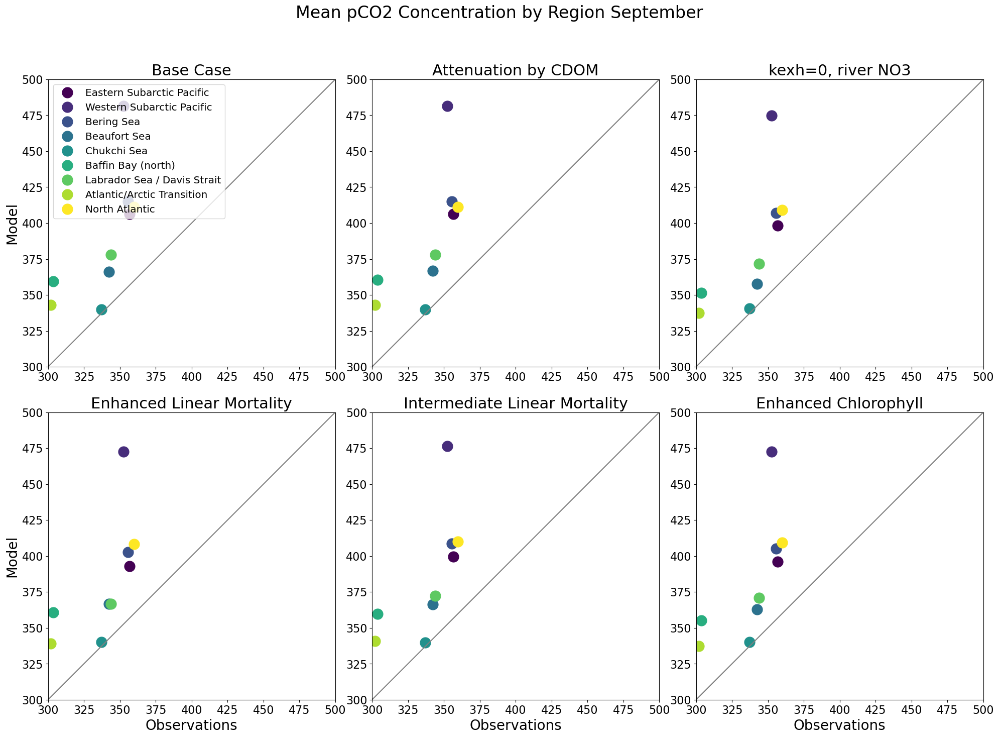

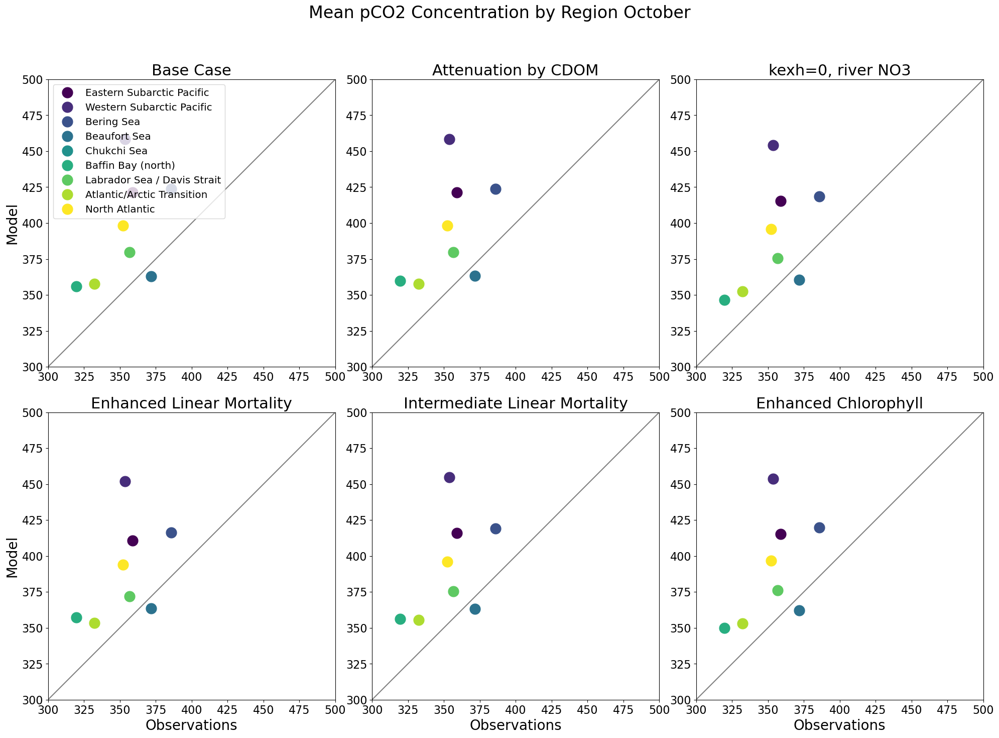

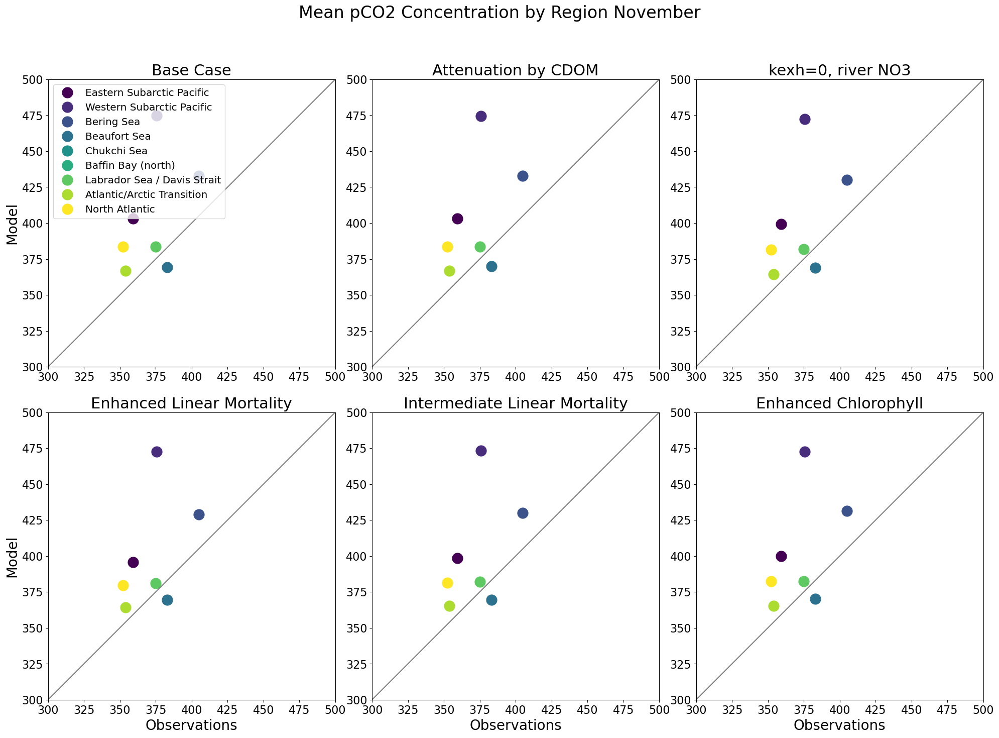

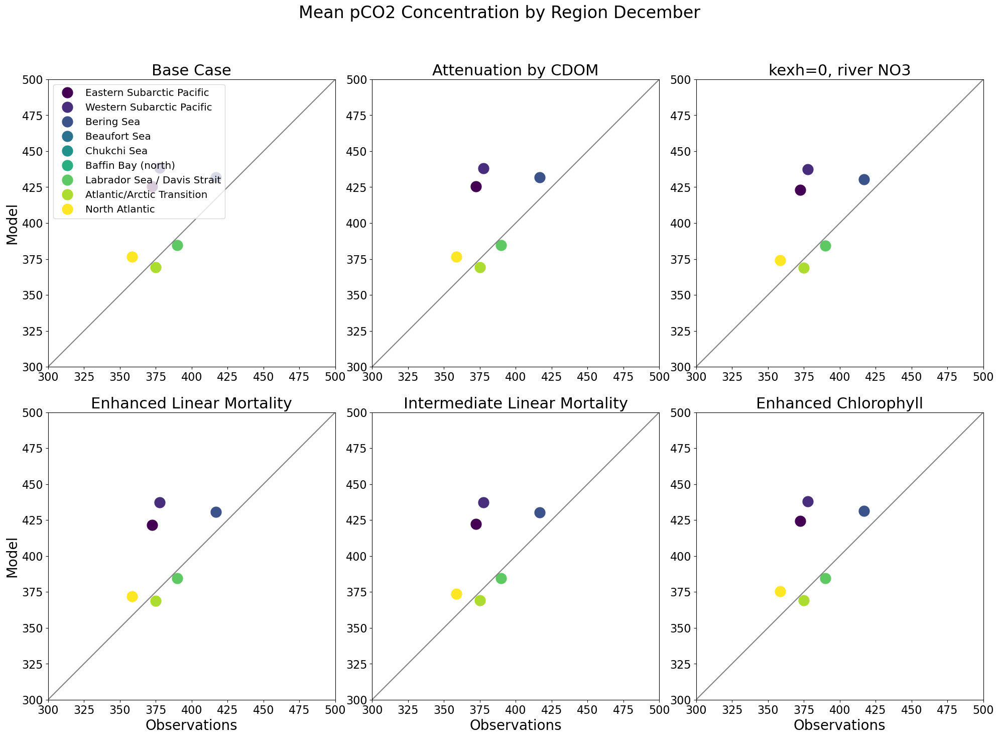

In [85]:
# Presentation quality plot for BioMod Workshop

#fig, axes = plt.subplots(num=1, clear=True, nrows=6, ncols=5, figsize=(30, 20))
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
import itertools
iz = np.arange(10)

months=['January','February','March','April','May','June','July','August','September','October','November','December']
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
#variants = ['-VJC014l','-VJC014w','-VJC014u','-VJC015a','-VJC015i','-VJC015q']
variants = ['VJC014l','VJC015t','VJC015u','VJC015v','VJC015w','VJC016c','VJC016d','VJCnep01']
variantdict = ['VJC014l','VJC015t','VJC015u','VJC015v','VJC015w','VJC016c','VJC016d','VJCnep01']


#variantdict = ['Base Case','Attenuation by CDOM','kexh=0, river NO3','Enhanced Linear Mortality',
#              'Intermediate Linear Mortality','Enhanced Chlorophyll']

for im, mmon in enumerate(months):
    
    fig, axes = plt.subplots(num=1, clear=True, nrows=2, ncols=4, figsize=(20, 15))
    fig.suptitle('Mean pCO2 Concentration by Region '+mmon, fontsize=24) 
    
    for a, asuff in enumerate(variants):
        cx=plt.subplot(2,4, a+1)
        runid = str('CREG025_LIM3_CANOE-'+asuff)
        #print(runid)
        data_all=np.zeros((12,ny,nx))
        flist = glob.glob("/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/"+runid+"_monthly_pco2.nc")
        flist.sort()
        #print(flist)
        ifile = 0
        colors =itertools.cycle(plt.get_cmap('viridis')(np.linspace(0,1, 9))) # potential pallettes: hsv, jet, gnuplot
        
        #for t, title in enumerate(variantdict):
        #    new = str(variantdict)
        #    plt.title(new, fontsize=18)  

        for i, c in enumerate(regions): 
            
            if i >= 0:
                
                filein = flist[ifile]
                data = Dataset(filein, "r", format="NETCDF4")
                modPCO2 = data.variables['pco2'][:]

                tmaskz=tmask[iz,:,:].flatten()
                ZZ=(np.zeros((10,ny,nx))+regindx).flatten()    # broadcast regions map into a 3D array with same data for each depth
                XOBS=obsPCO2[im,:,:].squeeze().flatten()
                XMOD=modPCO2[im,:,:].squeeze().flatten()
                ii=np.where( ~np.isnan(XOBS) )[0]
                XOBS=XOBS[ii]; XMOD=XMOD[ii]; ZZ=ZZ[ii]; tmaskz=tmaskz[ii];
                jj=np.where( (XOBS>0.) & (ZZ==(i+1)) & (tmaskz==1) )[0]
                XOBS=np.mean(XOBS[jj]); XMOD=np.mean(XMOD[jj])
                
                colour = next(colors) 
                #plt.plot(XOBS[jj], XMOD[jj], "o", color=colour, markeredgecolor=colour, label=regions)

                plt.plot(XOBS, XMOD, "o", color=colour, markeredgecolor=colour, markersize=15, label=regions)
            
            plt.ylim([300,500]); plt.xlim([300,500])
            cx.tick_params(axis='both', labelsize=16)
            cx.set_aspect(1./cx.get_data_ratio())
            #plt.xticks([200,400,600,800,1000]);plt.yticks([200,400,600,800,1000])
            plt.title(variantdict[a], fontsize=22)

            if a ==0:
                plt.legend(labels=['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic'],
                           fontsize='x-large', loc = 'upper left')
                
            if (a == 0) or (a == 3):
                plt.ylabel("Model", fontsize=20)

            if (a == 3) or (a == 4) or (a == 5):
                plt.xlabel("Observations", fontsize=20)

        cx.plot([0, 1], [0, 1], color='grey', transform=cx.transAxes)
            
    plt.tight_layout(rect=(0,0,1,0.95), w_pad=0)
    plt.show()
    #print(filein)
    #fig.savefig("oxygen_model_obs_month"+str("{:02d}".format(im+1)))
    fig.savefig("/home/fid000/WORK7/ANALYSIS/model_evaluation/FIGURES/PresentationFigures/tuvwcd/pCO2/pco2_month"+str("{:02d}".format(im+1)))

/tmp/ipykernel_6066/2016468231.py:40: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  modPCO2 = data.variables['pco2'][:]
/home/fid000/WORK7/software/anaconda3/envs/pypkg/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/fid000/WORK7/software/anaconda3/envs/pypkg/lib/python3.8/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


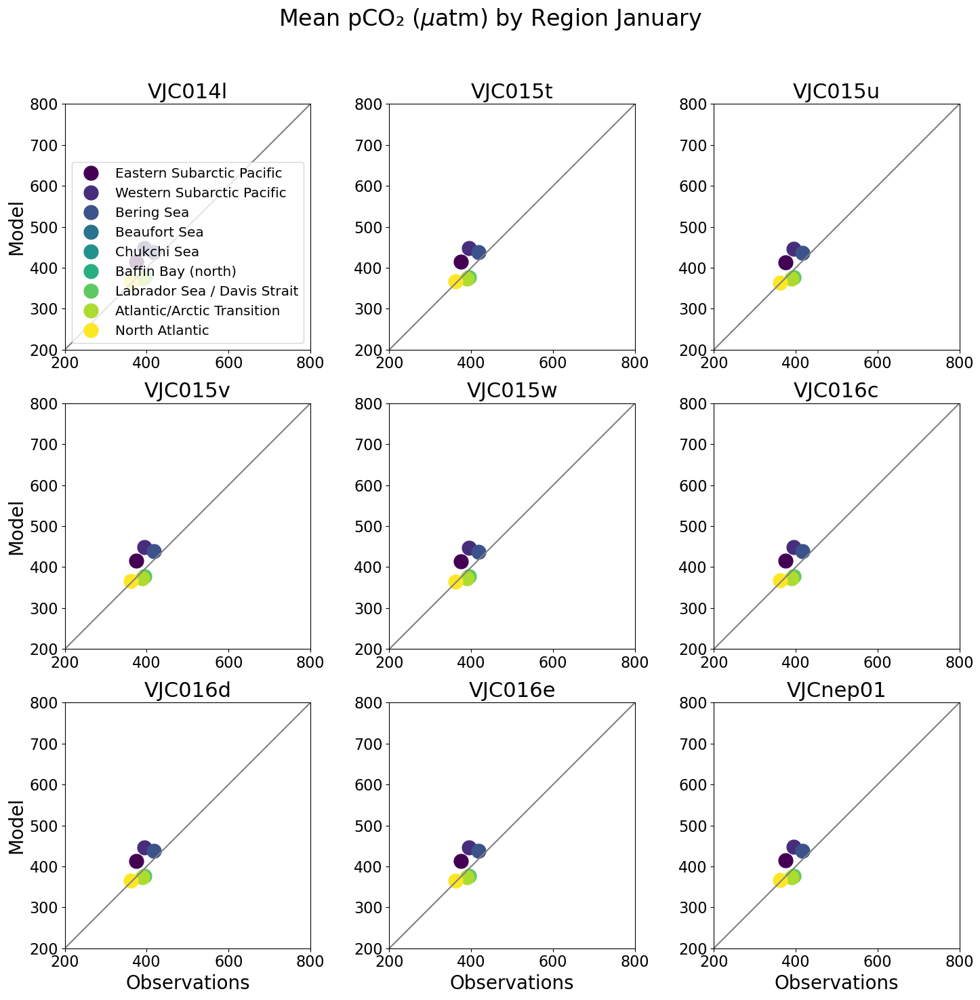

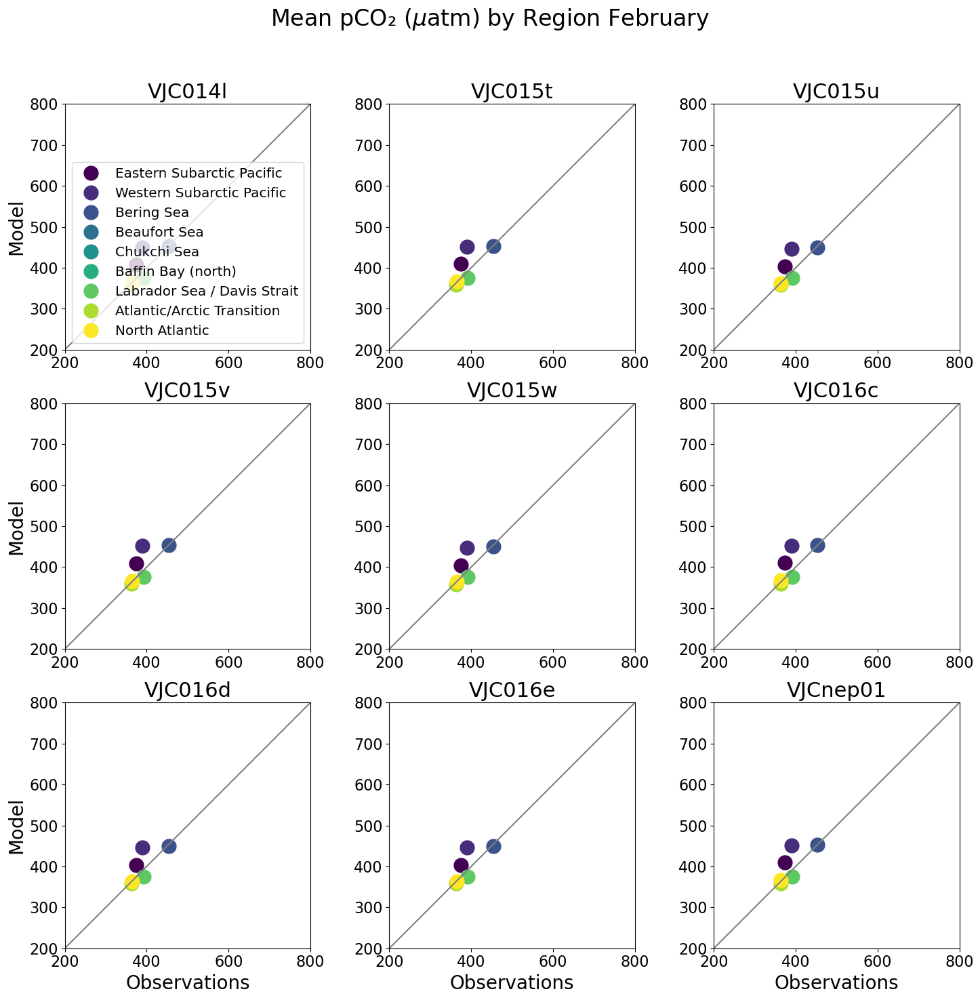

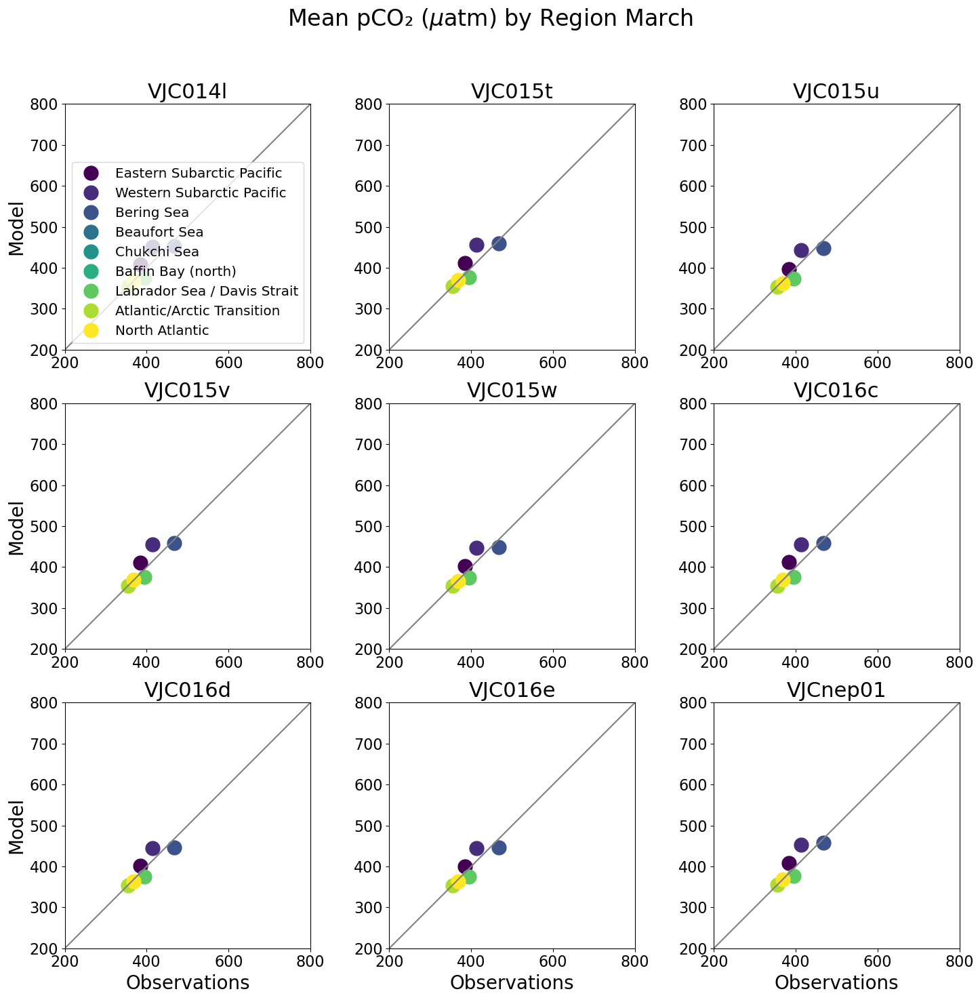

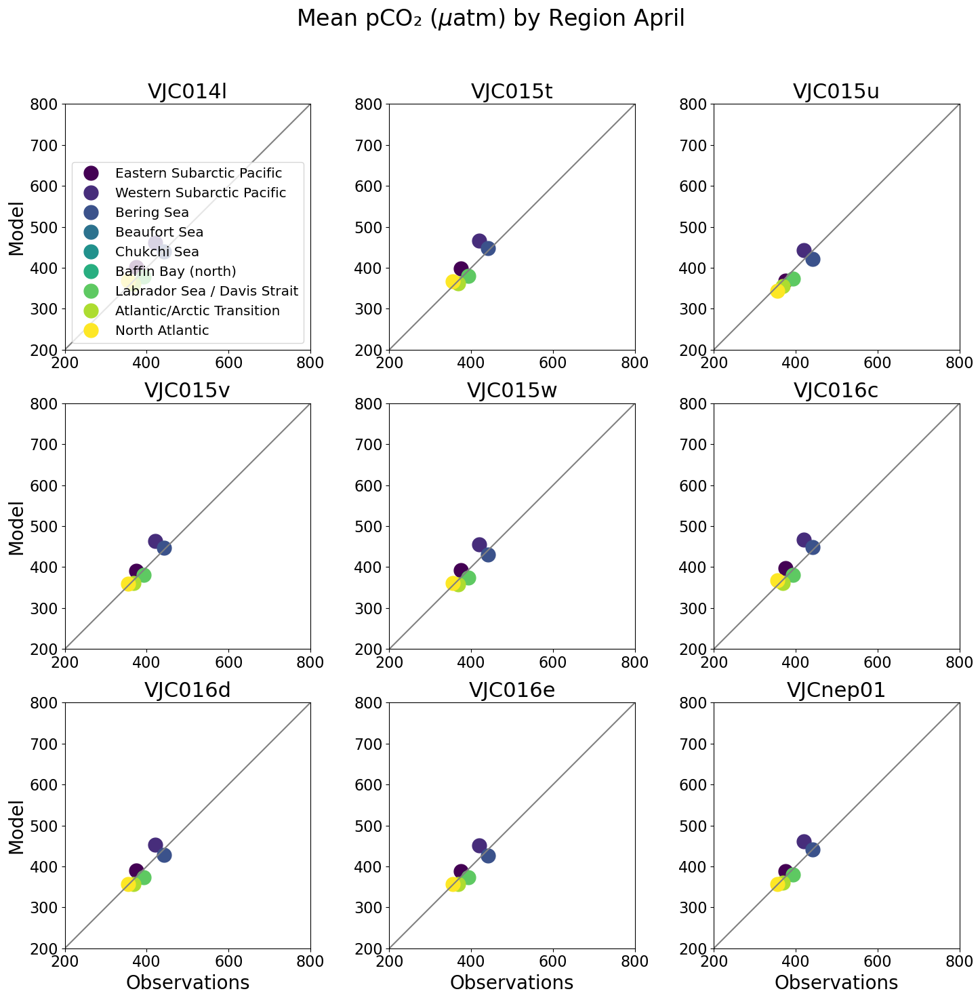

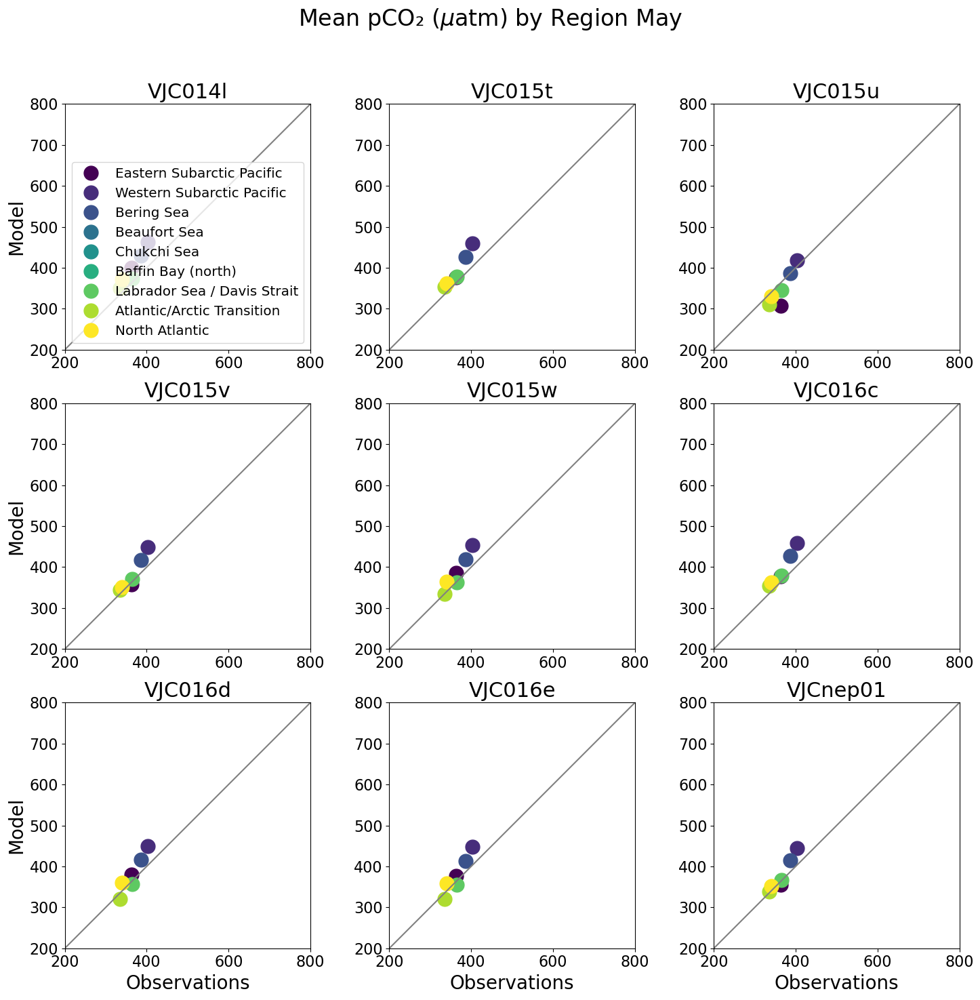

...

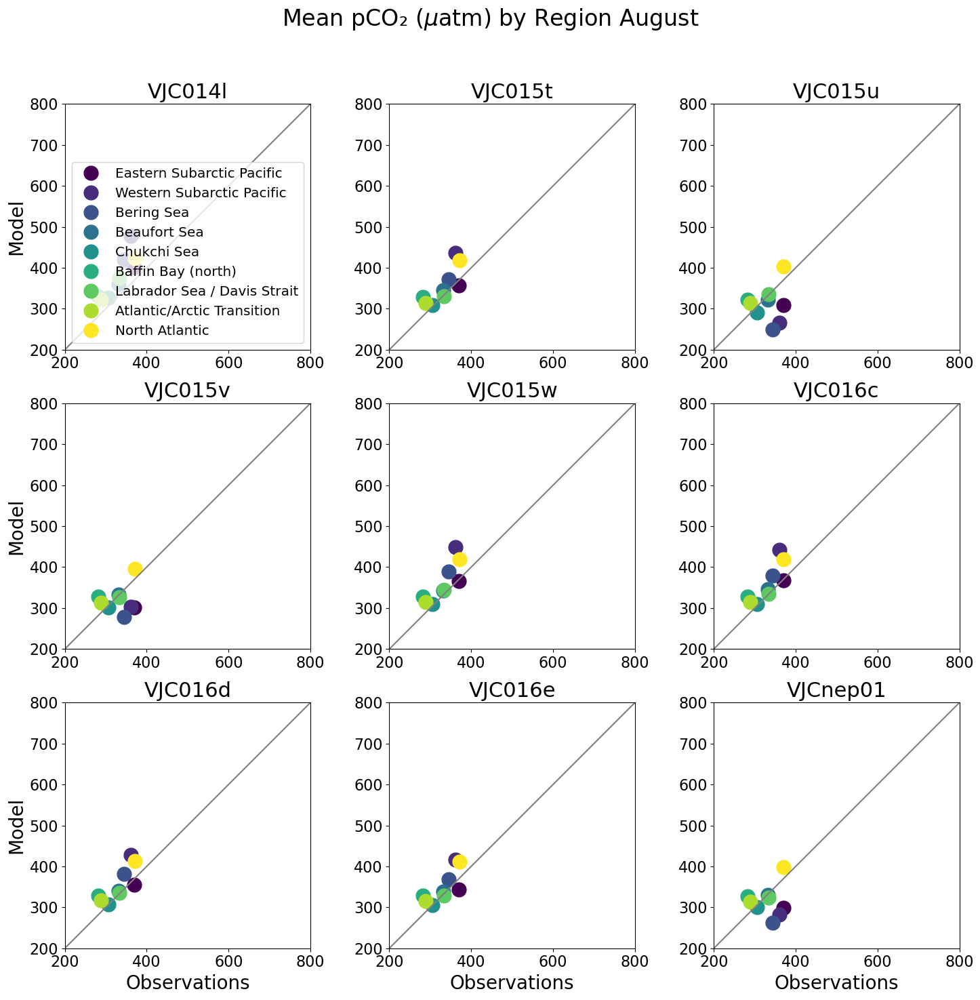

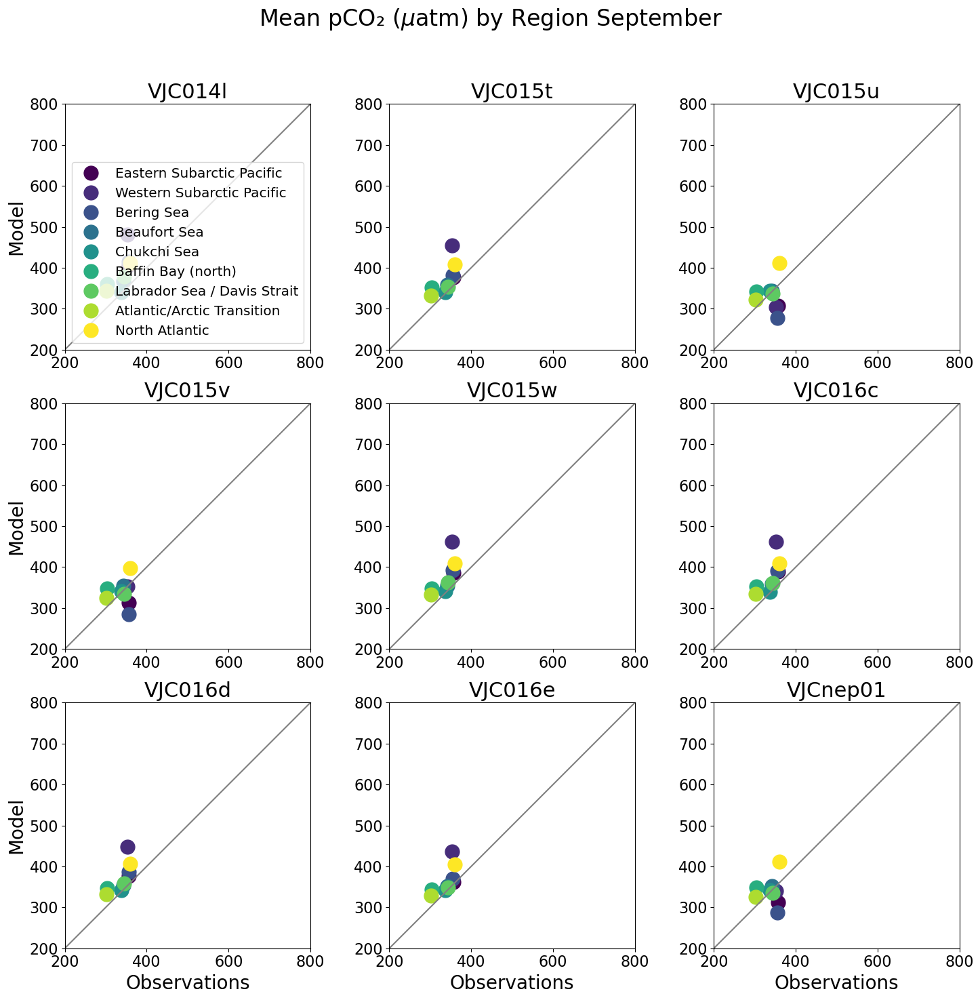

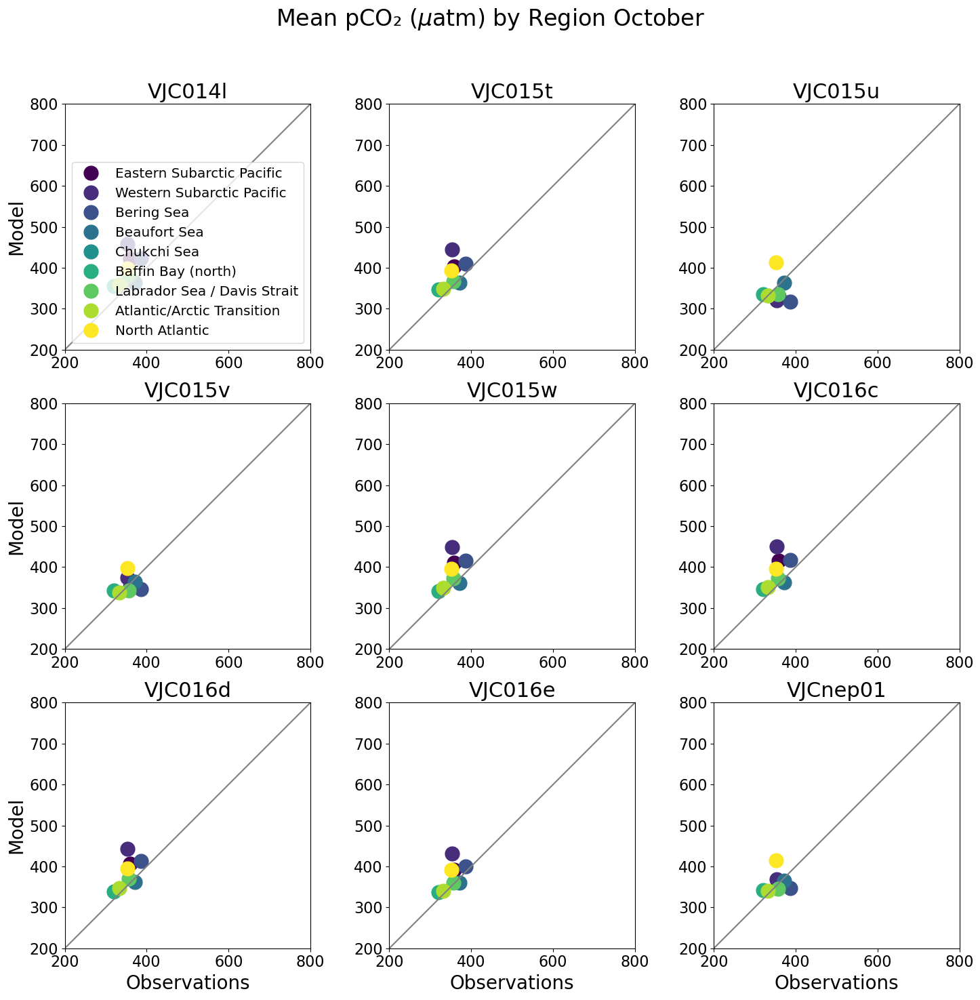

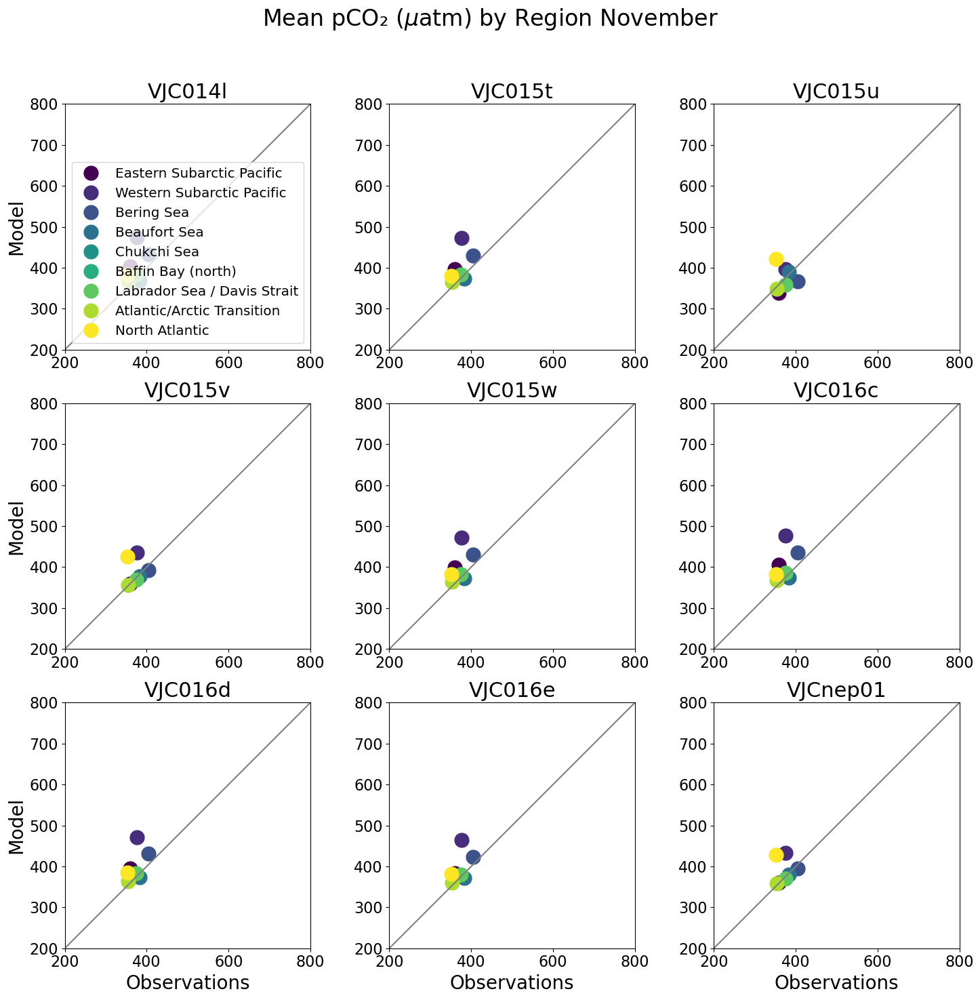

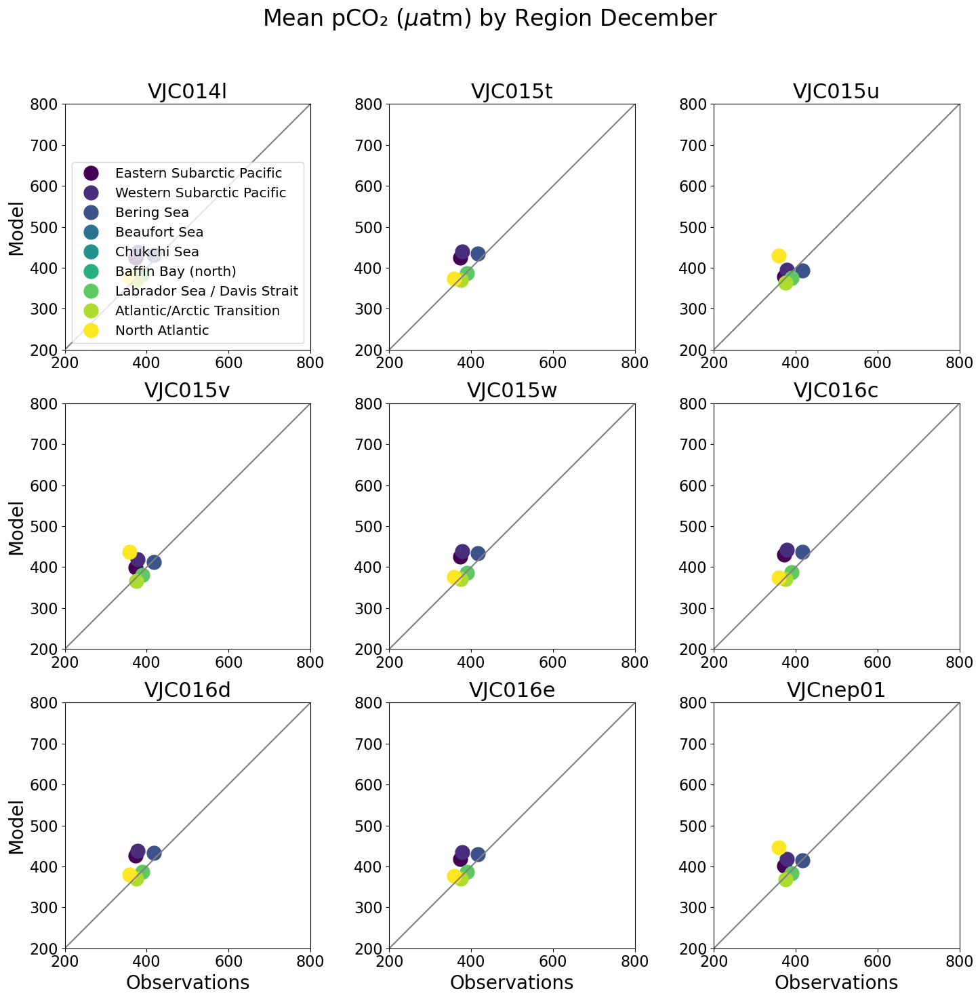

In [15]:
# Presentation quality plot for BioMod Workshop

#fig, axes = plt.subplots(num=1, clear=True, nrows=6, ncols=5, figsize=(30, 20))
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
import itertools
iz = np.arange(10)

months=['January','February','March','April','May','June','July','August','September','October','November','December']
regions = ['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic']
variants = ['VJC014l','VJC015t','VJC015u','VJC015v','VJC015w','VJC016c','VJC016d','VJC016e','VJCnep01']
variantdict = ['VJC014l','VJC015t','VJC015u','VJC015v','VJC015w','VJC016c','VJC016d','VJC016e','VJCnep01']


#variantdict = ['Base Case','gmax1=2.5','gmax2=1.35','reduced quadratic mortality (P+Zs)',
#              'reduced quadratic mortality (Zl)','NEP36 Parameters']

for im, mmon in enumerate(months):
    
    fig, axes = plt.subplots(num=1, clear=True, nrows=3, ncols=3, figsize=(15, 15))
    fig.suptitle('Mean pCO\u2082 ($\mu$atm) by Region '+mmon, fontsize=24) 
    #fig.suptitle('pCO\u2082 ($\mu$atm) by Region '+mmon, fontsize=24) 

    for a, asuff in enumerate(variants):
        cx=plt.subplot(3,3, a+1)
        runid = str('CREG025_LIM3_CANOE-'+asuff)
        #print(runid)
        data_all=np.zeros((12,ny,nx))
        flist = glob.glob("/gpfs/fs7/dfo/hpcmc/comda/stod000/CREG25/processed_op/pco2/"+runid+"_monthly_pco2.nc")
        flist.sort()
        #print(flist)
        ifile = 0
        colors =itertools.cycle(plt.get_cmap('viridis')(np.linspace(0,1, 9))) # potential pallettes: hsv, jet, gnuplot

        for i, c in enumerate(regions): 
            
            if i >= 0:
                
                filein = flist[ifile]
                data = Dataset(filein, "r", format="NETCDF4")
                modPCO2 = data.variables['pco2'][:]

                tmaskz=tmask[iz,:,:].flatten()
                ZZ=(np.zeros((10,ny,nx))+regindx).flatten()    # broadcast regions map into a 3D array with same data for each depth
                XOBS=obsPCO2[im,:,:].squeeze().flatten()
                XMOD=modPCO2[im,:,:].squeeze().flatten()
                ii=np.where( ~np.isnan(XOBS) )[0]
                XOBS=XOBS[ii]; XMOD=XMOD[ii]; ZZ=ZZ[ii]; tmaskz=tmaskz[ii];
                jj=np.where( (XOBS>0.) & (ZZ==(i+1)) & (tmaskz==1) )[0]
                XOBS=np.mean(XOBS[jj]); XMOD=np.mean(XMOD[jj])
                
                colour = next(colors) 
                #plt.plot(XOBS[jj], XMOD[jj], "o", color=colour, markeredgecolor=colour, label=regions)

                plt.plot(XOBS, XMOD, "o", color=colour, markeredgecolor=colour, markersize=15, label=regions)
            
            plt.ylim([200,800]); plt.xlim([200,800])
            cx.tick_params(axis='both', labelsize=16)
            cx.set_aspect(1./cx.get_data_ratio())
            #plt.xticks([200,400,600,800,1000]);plt.yticks([200,400,600,800,1000])
            plt.title(variantdict[a], fontsize=22)

            if a ==0:
                plt.legend(labels=['Eastern Subarctic Pacific', 'Western Subarctic Pacific', 'Bering Sea', 'Beaufort Sea', 'Chukchi Sea', 'Baffin Bay (north)', 'Labrador Sea / Davis Strait', 'Atlantic/Arctic Transition', 'North Atlantic'],
                           fontsize='x-large', loc = 'lower right')
                
            if (a == 0) or (a == 3) or (a == 6):
                plt.ylabel("Model", fontsize=20)

            if (a == 6) or (a == 7) or (a == 8):
                plt.xlabel("Observations", fontsize=20)

        cx.plot([0, 1], [0, 1], color='grey', transform=cx.transAxes)
            
    plt.tight_layout(rect=(0,0,1,0.95), w_pad=0)
    plt.show()
    fig.savefig("/home/fid000/WORK7/ANALYSIS/model_evaluation/FIGURES/PresentationFigures/tuvwcde/pCO2/pco2_means_month"+str("{:02d}".format(im+1)))
    #fig.savefig("/home/fid000/WORK7/ANALYSIS/model_evaluation/FIGURES/PresentationFigures/tuvwcde/pCO2/pco2_month"+str("{:02d}".format(im+1)))